<a href="https://colab.research.google.com/github/dkalenov/The-Simpsons-characters-Classification-DL/blob/main/The_Simpsons_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Проект по классификации изображений

Будем решать достаточно известную задачу классификации персонажей всем известного мультсериала :)








Используйте все полученные знания (можно и выйти за рамки пройденного материала), чтобы добиться наилучшего качества модели на тестовом наборе данных (accuracy).
Минимальное требуемое значения метрики - 0.83. Постарайтесь получить 0.95+ ;)

Кроме построения нейросети и оценки её качества вам необходимо:
- замерять время обучения сети;
- написать функцию, которая на вход будет принимать ссылку на произвольное изображение и прогнозировать его класс;
- написать код, который будет выводть 9 случайных изображений из теста с их фактическими и прогнозными классами.

Изучите классы, на которых модель чаще всего ошибается, напишите финальные выводы и пути дальнейшего улучшения работы.

![alt text](https://www.indiewire.com/wp-content/uploads/2014/08/the-simpsons.jpg)

Данные можно скачать [ссылке](https://disk.yandex.ru/d/U9bpivZ-Tpknfw).



In [ ]:
!pip install wldhx.yadisk-direct
!curl -L $(yadisk-direct https://disk.yandex.ru/d/U9bpivZ-Tpknfw) -o simspons.zip
!unzip -qq simspons.zip
!pip install torchmetrics

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  520M  100  520M    0     0  15.5M      0  0:00:33  0:00:33 --:--:-- 17.2M
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.4/840.4 kB 11.1 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
from PIL import Image
from pathlib import Path
from torchvision import transforms
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import copy
import time
from tqdm import tqdm
import sys
import random
import torchvision.models as models
import matplotlib.pyplot as plt
import torch.optim as optim
import copy
import os
import requests
from io import BytesIO
from torch.utils.data import random_split
import seaborn as sns
from torchmetrics import ConfusionMatrix

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
# Датафрейм с информацией о моделях
models_df = pd.DataFrame(columns=['name',
                        'loss',
                        'acc',
                        'time',
                        'learning_rate',
                        'epochs'])

Даталоадер за вас уже написаны :)

ToTensor конвертирует  PIL Image с параметрами в диапазоне [0, 255] (как все пиксели) в FloatTensor размера (C x H x W) [0,1] , затем производится масштабирование:
$input = \frac{input - \mu}{\text{standard deviation}} $, <br>       константы - средние и дисперсии по каналам на основе ImageNet

Также используется LabelEncoder для преобразования строковых меток классов в id и обратно. Картинки разного размера, так как брались напрямую с видео, поэтому следуем привести их к одному размер (это делает метод  _prepare_sample).

# Загрузка данных

In [ ]:
# Функция для вывода распределения данных
def get_class_distribution(train_dataset, val_dataset):
    # Общее количество объектов в тренировочной и валидационной выборках
    train_all_counts = len(train_dataset)
    val_all_counts = len(val_dataset)

    # Получаем метки классов для тренировочной и валидационной выборок
    train_labels = train_dataset.labels
    val_labels = val_dataset.labels

    # Создаем словари для подсчета количества элементов в каждом классе
    train_class_counts = {}
    val_class_counts = {}

    # Выполняем подсчет для каждой метки класса в тренировочной выборке
    for train_label in train_labels:
        train_class_counts[train_label] = train_class_counts.get(train_label, 0) + 1

    # Выполняем подсчет для каждой метки класса в валидационной выборке
    for val_label in val_labels:
        val_class_counts[val_label] = val_class_counts.get(val_label, 0) + 1

    # Создаем датафрейм для тренировочной выборки
    train_df = pd.DataFrame(list(train_class_counts.items()), columns=['Класс', 'Train'])

    # Создаем датафрейм для валидационной выборки
    val_df = pd.DataFrame(list(val_class_counts.items()), columns=['Класс', 'Validation'])

    # Объединяем датафреймы
    distribution_df = pd.merge(train_df, val_df, on='Класс')
    distribution_df['Sum'] = distribution_df['Train'] + distribution_df['Validation']

    print(f"Всего объектов в тренировочной выборке: {train_all_counts}")
    print(f"Всего объектов в валидационной выборке: {val_all_counts}")

    # Сортируем датафрейм в порядке убывания
    distribution_df = distribution_df.sort_values('Train', ascending=False)

    return distribution_df

In [ ]:
# разные режимы загрузки датасета
data_modes = ['train', 'val', 'test']

class SimpsonsDataset(Dataset):
    """
    Датасет с картинками, который паралельно подгружает их из папок
    производит скалирование и превращение в торчевые тензоры
    """
    def __init__(self, files, mode):
        super().__init__()
        # список файлов для загрузки
        self.files = sorted(files)
        # режим работы
        self.mode = mode

        self.len_ = len(self.files)

        self.label_encoder = LabelEncoder()

        if self.mode != 'test':
            self.labels = [path.parent.name for path in self.files]
            self.label_encoder.fit(self.labels)


    def __len__(self):
        return self.len_

    def load_sample(self, file):
        image = Image.open(file)
        image.load()
        return image

    def __getitem__(self, index):
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ])
        x = self.load_sample(self.files[index])
        x = self._prepare_sample(x)
        x = np.array(x / 255, dtype='float32')
        x = transform(x)
        if self.mode == 'test':
            return x
        else:
            label = self.labels[index]
            label_id = self.label_encoder.transform([label])
            y = label_id.item()
            return x, y

    def _prepare_sample(self, image):
        image = image.resize((224, 224))
        return np.array(image)

Читаем данные

In [ ]:
train_dir = Path('train/simpsons_dataset')
test_dir = Path('testset/testset')

train_val_files = list(train_dir.rglob('*.jpg'))
test_files = list(test_dir.rglob('*.jpg'))

Разделяем на выборки

In [ ]:
from sklearn.model_selection import train_test_split

train_val_labels = [path.parent.name for path in train_val_files]
train_files, val_files = train_test_split(train_val_files, test_size=0.25, \
                                          stratify=train_val_labels)

In [ ]:
train_dataset = SimpsonsDataset(train_files, mode='train')
val_dataset = SimpsonsDataset(val_files, mode='val')
test_dataset = SimpsonsDataset(test_files, mode='test')

In [ ]:
init_train_dataset = len(train_dataset)
init_val_dataset = len(val_dataset)
init_test_dataset = len(test_dataset)

In [ ]:
print(init_train_dataset)
print(init_val_dataset)
print(init_test_dataset)

15699
5234
991


In [ ]:
# class_names = train_dataset.label_encoder.classes_
class_names = train_dataset.label_encoder.classes_
class_names

array(['abraham_grampa_simpson', 'agnes_skinner',
       'apu_nahasapeemapetilon', 'barney_gumble', 'bart_simpson',
       'carl_carlson', 'charles_montgomery_burns', 'chief_wiggum',
       'cletus_spuckler', 'comic_book_guy', 'disco_stu', 'edna_krabappel',
       'fat_tony', 'gil', 'groundskeeper_willie', 'homer_simpson',
       'kent_brockman', 'krusty_the_clown', 'lenny_leonard',
       'lionel_hutz', 'lisa_simpson', 'maggie_simpson', 'marge_simpson',
       'martin_prince', 'mayor_quimby', 'milhouse_van_houten',
       'miss_hoover', 'moe_szyslak', 'ned_flanders', 'nelson_muntz',
       'otto_mann', 'patty_bouvier', 'principal_skinner',
       'professor_john_frink', 'rainier_wolfcastle', 'ralph_wiggum',
       'selma_bouvier', 'sideshow_bob', 'sideshow_mel', 'snake_jailbird',
       'troy_mcclure', 'waylon_smithers'], dtype='<U24')

In [ ]:
num_classes = len(train_dataset.label_encoder.classes_)
num_classes

42

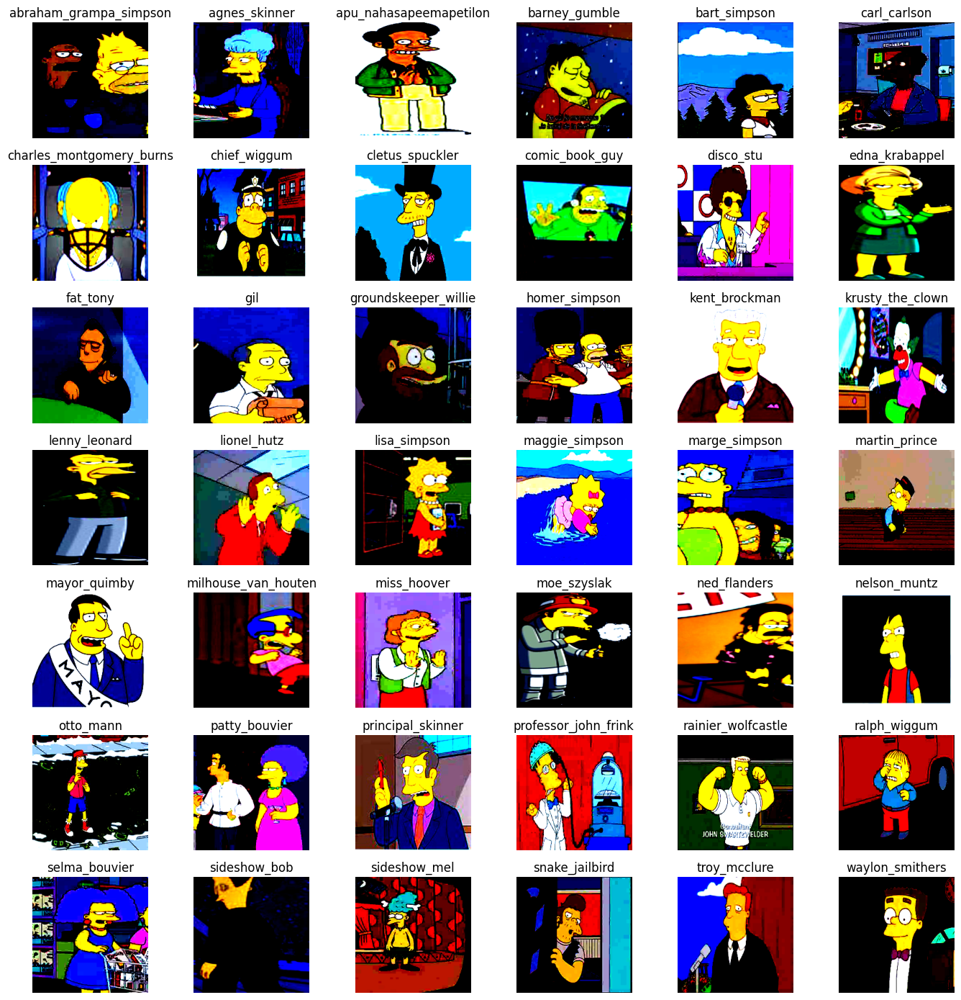

In [ ]:
# выведем по одному изображению из каждого класса

class_images = {}

for class_name in class_names:
    class_images[class_name] = []

for i in range(len(train_dataset)):
    image, label = train_dataset[i]
    class_name = train_dataset.label_encoder.inverse_transform([label])[0]
    if len(class_images[class_name]) < 1:
        class_images[class_name].append(image)

fig, axs = plt.subplots(7, 6, figsize=(14, 14))
plt.subplots_adjust(hspace=0.4)

for i, class_name in enumerate(class_names):
    image = class_images[class_name][0]
    image = image.numpy().transpose(1, 2, 0)
    image = np.clip(image, 0, 1)  # Ограничение значений пикселей
    axs[i // 6, i % 6].imshow(image)
    axs[i // 6, i % 6].set_title(f'{class_name}')
    axs[i // 6, i % 6].axis('off')

plt.tight_layout()
plt.show()

#### Распределение данных

In [ ]:
init_distribution = get_class_distribution(train_dataset, val_dataset)
init_distribution

Всего объектов в тренировочной выборке: 15699
Всего объектов в валидационной выборке: 5234


,Класс,Train,Validation,Sum
15,homer_simpson,1684,562,2246
28,ned_flanders,1090,364,1454
27,moe_szyslak,1089,363,1452
20,lisa_simpson,1015,339,1354
4,bart_simpson,1006,336,1342
22,marge_simpson,968,323,1291
17,krusty_the_clown,904,302,1206
6,charles_montgomery_burns,895,298,1193
32,principal_skinner,895,299,1194
25,milhouse_van_houten,809,270,1079


#### Аугментирование малочисленных классов

Можно попробовать многократно увеличить количество данных с помощью аугментации копий картинок. Однако эксперименты на малых наборах данных в предыдущей работе (ДЗ-2 классификация суши, пицца, стейк) показали, что многократное копирование и аугментированаие одних и тех же данных в большентсве случаев приводит к сильному переобучению моделей. Поэтому в данной работе аугментация на копированных данных будет осуществляться единожды, таким образом, количество картинок в выбранных классах увеличится вдвое.

In [ ]:
# Список классов для аугментации
aug_class_names = ['maggie_simpson', 'groundskeeper_willie', 'barney_gumble', 'selma_bouvier', 'carl_carlson',
                   'ralph_wiggum', 'patty_bouvier', 'martin_prince', 'professor_john_frink', 'snake_jailbird',
                   'cletus_spuckler', 'rainier_wolfcastle', 'agnes_skinner', 'sideshow_mel', 'otto_mann', 'gil',
                   'fat_tony', 'miss_hoover', 'disco_stu', 'troy_mcclure', 'lionel_hutz']


In [ ]:
import os
import shutil
import random
from PIL import Image
from PIL import ImageOps
from PIL import ImageEnhance
from PIL import ImageFilter

# Создание директории 'simpsons_dataset_augmented', если она не существует
if not os.path.exists('simpsons_dataset_augmented'):
    os.makedirs('simpsons_dataset_augmented')

# Перенос классов, которых нет в списке aug_class_names в директорию simpsons_dataset_augmented
for class_name in class_names:
    class_dir = os.path.join('train', 'simpsons_dataset', class_name)
    class_augmented_dir = os.path.join('simpsons_dataset_augmented', class_name)

    if class_name not in aug_class_names and os.path.exists(class_dir):
        shutil.copytree(class_dir, class_augmented_dir)

# Копирование и аугментация файлов для каждого класса
for class_name in aug_class_names:
    class_dir = os.path.join('train', 'simpsons_dataset', class_name)
    class_augmented_dir = os.path.join('simpsons_dataset_augmented', class_name)

    # Создание директории для аугментированных файлов, если она еще не существует
    if not os.path.exists(class_augmented_dir):
        os.makedirs(class_augmented_dir)

    # Если директория с аугментированными файлами уже существует, пропустить этот класс
    elif os.path.exists(os.path.join(class_augmented_dir)):
        continue

    # Копирование файлов класса в директорию аугментированных файлов
    files = os.listdir(class_dir)
    for file in files:
        src_file = os.path.join(class_dir, file)
        dst_file = os.path.join(class_augmented_dir, file)
        shutil.copy(src_file, dst_file)

    # Аугментация файлов в директории аугментированных файлов
    augmented_files = os.listdir(class_augmented_dir)
    for file in augmented_files:
        file_path = os.path.join(class_augmented_dir, file)
        augmented_file_path = os.path.join(class_augmented_dir, 'augmented_' + file)

        # Применение случайной аугментации к файлу
        image = Image.open(file_path)

        # Случайное отзеркаливание по горизонтали
        if random.random() < 0.5:
            image = ImageOps.mirror(image) # Аугментация через зеркальное отображение
        else:
            angle = random.randint(-50, 50) # Поворот на случайный угол (от -20 до 20 градусов)
            image = image.rotate(angle)

        # Аугментация через изменение яркости
        enhancer = ImageEnhance.Brightness(image)
        factor = random.uniform(0.75, 1.5)
        image = enhancer.enhance(factor)

        # # Изменение контраста (случайный фактор от 0.5 до 1.5)
        # contrast_factor = random.uniform(0.5, 1.5)
        # image = ImageEnhance.Contrast(image).enhance(contrast_factor)

        # Аугментация через размытие
        factor = random.uniform(0.5, 1.5)
        image = image.filter(ImageFilter.GaussianBlur(radius=factor))

        # # Повышение резкости (случайный фактор от 0.5 до 1.5)
        # sharpness_factor = random.uniform(0.5, 1.5)
        # image = ImageEnhance.Sharpness(image).enhance(sharpness_factor)

        image.save(augmented_file_path)

print("Аугментация завершена")

Выведем оригинальные и аугментированные изображения

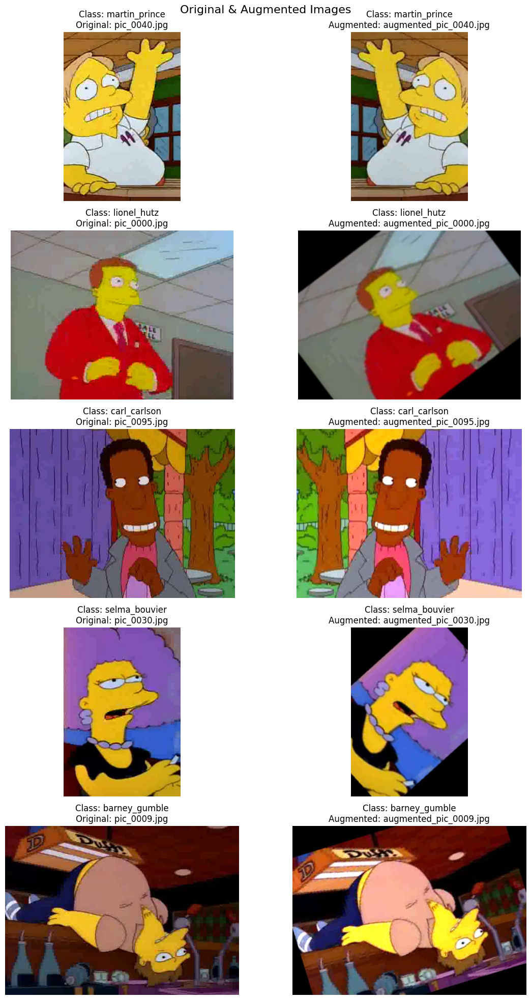

In [ ]:
import os
import random
import matplotlib.pyplot as plt

# Выбор 5 случайных классов
random_classes = random.sample(aug_class_names, 5)

# Создание фигуры и осей для отображения изображений
fig, ax = plt.subplots(nrows=5, ncols=2, figsize=(12, 20))

# Итерация по каждому случайному классу
for i, class_name in enumerate(random_classes):
    class_dir = os.path.join('simpsons_dataset_augmented', class_name)

    # Флаг для отслеживания наличия аугментированного файла
    found_augmented_file = False

    # Повторение выбора случайного файла и проверки наличия аугментированного файла
    while not found_augmented_file:
        # Получение списка всех файлов для данного класса
        files = os.listdir(class_dir)

        # Определение случайного файла оригинала
        original_file = random.choice(files)

        # Определение соответствующего файла аугментированного изображения
        augmented_base = os.path.splitext(original_file)[0]
        augmented_file = f'augmented_{augmented_base}.jpg'

        # Получение полных путей к файлам
        original_file_path = os.path.join(class_dir, original_file)
        augmented_file_path = os.path.join(class_dir, augmented_file)

        # Проверка существования файла аугментированного изображения
        if os.path.isfile(augmented_file_path):
            # Загрузка оригинального и аугментированного изображений
            original_image = plt.imread(original_file_path)
            augmented_image = plt.imread(augmented_file_path)

            # Отображение оригинального изображения
            ax[i, 0].imshow(original_image)
            ax[i, 0].axis('off')
            ax[i, 0].set_title(f'Class: {class_name}\nOriginal: {original_file}')

            # Отображение аугментированного изображения
            ax[i, 1].imshow(augmented_image)
            ax[i, 1].axis('off')
            ax[i, 1].set_title(f'Class: {class_name}\nAugmented: {augmented_file}')

            # Установка флага found_augmented_file в True, чтобы выйти из цикла
            found_augmented_file = True


# Установка заголовка для фигуры
fig.suptitle('Original & Augmented Images', fontsize=16)

# Отображение фигуры
plt.tight_layout()
plt.show()

#### Сокращение кол-ва изображений в превалирующих классах

Сбалансируем классы с помощью удаления случайных изображений из привалирующих классов

In [ ]:
train_dir_aug = Path('simpsons_dataset_augmented')
train_files_aug = list(train_dir_aug.rglob('*.jpg'))
train_dataset_aug = SimpsonsDataset(train_files_aug, mode='train')

Посмотрим, сколько изображений стало после аугментации

In [ ]:
import os

class_counts = {}

# Перебирать классы в директории simpsons_dataset_augmented
for class_name in os.listdir('simpsons_dataset_augmented'):
    class_dir = os.path.join('simpsons_dataset_augmented', class_name)

    # Подсчитывать количество файлов в каждом классе
    num_files = len(os.listdir(class_dir))
    class_counts[class_name] = num_files


# Отсортировать словарь по убыванию количества объектов
sorted_class_counts = dict(sorted(class_counts.items(), key=lambda x: x[1], reverse=True))
sorted_class_counts

{'homer_simpson': 2246,
 'ned_flanders': 1454,
 'moe_szyslak': 1452,
 'lisa_simpson': 1354,
 'bart_simpson': 1342,
 'marge_simpson': 1291,
 'krusty_the_clown': 1206,
 'principal_skinner': 1194,
 'charles_montgomery_burns': 1193,
 'milhouse_van_houten': 1079,
 'chief_wiggum': 986,
 'abraham_grampa_simpson': 913,
 'sideshow_bob': 877,
 'apu_nahasapeemapetilon': 623,
 'kent_brockman': 498,
 'comic_book_guy': 469,
 'edna_krabappel': 457,
 'nelson_muntz': 358,
 'lenny_leonard': 310,
 'maggie_simpson': 256,
 'mayor_quimby': 246,
 'groundskeeper_willie': 242,
 'barney_gumble': 212,
 'selma_bouvier': 206,
 'carl_carlson': 196,
 'waylon_smithers': 181,
 'ralph_wiggum': 178,
 'patty_bouvier': 144,
 'martin_prince': 142,
 'professor_john_frink': 130,
 'snake_jailbird': 110,
 'cletus_spuckler': 94,
 'rainier_wolfcastle': 90,
 'agnes_skinner': 84,
 'sideshow_mel': 80,
 'otto_mann': 64,
 'gil': 54,
 'fat_tony': 54,
 'miss_hoover': 34,
 'disco_stu': 16,
 'troy_mcclure': 16,
 'lionel_hutz': 6}

In [ ]:
# Функция для удаления нужного количества случайных изображений в выбранных классах


def balance_dataset(dataset, class_dict):
    removed_files = []  # пустой список для сохранения удаленных файлов

    # Проходим по элементам словаря class_dict
    for class_name, num_images_to_remove in class_dict.items():
        # Находим индексы элементов набора данных, у которых метка соответствует текущему классу
        class_indices = [i for i, label in enumerate(dataset.labels) if label == class_name]
        # Вычисляем количество изображений для удаления, оно равно минимуму из указанного значения и количества индексов
        num_images_to_remove = min(num_images_to_remove, len(class_indices))
        # Выбираем случайные индексы для удаления
        indices_to_remove = random.sample(class_indices, num_images_to_remove)

        # Проходим по значениям индексов в обратном порядке
        for i in sorted(indices_to_remove, reverse=True):
            # Удаляем соответствующий файл и метку из набора данных, добавляем их в список удаленных файлов
            removed_file = dataset.files.pop(i)
            removed_label = dataset.labels.pop(i)
            removed_files.append((removed_file, removed_label))

    # Обновляем значение dataset.len_ равным новой длине списка файлов
    dataset.len_ = len(dataset.files)

    return dataset, removed_files

In [ ]:
class_dict = {"homer_simpson": 1246,
              'ned_flanders':	454,
              'moe_szyslak': 452,
              'lisa_simpson':	354,
              'bart_simpson':	342,
              'marge_simpson':	291,
              'krusty_the_clown':	206,
              'principal_skinner':	194,
              'charles_montgomery_burns':	193,
              'milhouse_van_houten': 79}



balanced_dataset, removed_files = balance_dataset(train_dataset_aug, class_dict)

In [ ]:
# после удаления всего картинок:
balanced_dataset.len_

18326

In [ ]:
balanced_dataset

Разделяем balanced_dataset на тренировочную и валидационную выборки

In [ ]:
train_ratio = 0.75

# Получаяем индексы всех изображений в датасете
indices = list(range(len(balanced_dataset.files)))

# Случайно перемешиваем индексы
random.shuffle(indices)

# Разделям индексы на тренировочную и валидационную выборки
train_size = int(train_ratio * len(balanced_dataset.files))
train_indices = indices[:train_size]
val_indices = indices[train_size:]

# В валидационную часть будем добавлять только оригинальные изображения
val_files = [balanced_dataset.files[i] for i in val_indices if 'augmented' not in balanced_dataset.files[i].name]

train_files = [balanced_dataset.files[i] for i in train_indices]


# Создаём датасеты
train_dataset = SimpsonsDataset(train_files, mode='train')
val_dataset = SimpsonsDataset(val_files, mode='val')

In [ ]:
get_class_distribution(train_dataset, val_dataset)

Всего объектов в тренировочной выборке: 13744
Всего объектов в валидационной выборке: 4273


,Класс,Train,Validation,Sum
27,ned_flanders,765,235,1000
15,homer_simpson,762,238,1000
26,moe_szyslak,761,239,1000
4,bart_simpson,755,245,1000
24,milhouse_van_houten,751,249,1000
17,krusty_the_clown,748,252,1000
6,charles_montgomery_burns,742,258,1000
21,marge_simpson,739,261,1000
31,principal_skinner,736,264,1000
19,lisa_simpson,732,268,1000


In [ ]:
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

13744
4273
991


#### Датасеты

Создаём второй набор датасетов, состящий из оригинальных данных.
Таким образом, будет два набора тренировочных и валидационных данных:
1. train_dataset и val_dataset - датасеты с более сбалансированными классами и аугментацией на малочисленных классах;
2. train_dataset_f и val_dataset_f - оригинальный набор данных.

In [ ]:
train_dir_f = Path('train/simpsons_dataset')

train_val_files_f = list(train_dir_f.rglob('*.jpg'))

from sklearn.model_selection import train_test_split

train_val_labels_f = [path.parent.name for path in train_val_files_f]
train_files_f, val_files_f = train_test_split(train_val_files_f, test_size=0.25, \
                                          stratify=train_val_labels_f)

train_dataset_f = SimpsonsDataset(train_files_f, mode='train')
val_dataset_f = SimpsonsDataset(val_files_f, mode='val')
test_dataset_f = SimpsonsDataset(test_files, mode='test')

print(len(train_dataset_f))
print(len(val_dataset_f))
print(len(test_dataset_f))

15699
5234
991


# Обучение

## Функции

### Функции для обучения и оценки модели

In [ ]:
# функция для заморозки слоёв

def create_model(model, num_freeze_layers, num_ftrs, num_out_classes):
    # замена последнего слоя сети
    model.fc = nn.Linear(num_ftrs, num_out_classes)

    # заморозка слоев
    for i, layer in enumerate(model.children()):
        if i < num_freeze_layers:
            for param in layer.parameters():
                param.requires_grad = False

    return model

In [ ]:
# Функция обучения + оценки

def train(model, train_loader, val_loader, loss_fn, optimizer, epochs):
    model.to(device)
    model.train()

    train_losses = []
    train_accuracies = []
    val_losses = []
    val_accuracies = []
    total_time = 0

    for epoch in range(epochs):
        epoch_start_time = time.time()
        train_loss = 0
        correct = 0
        progress_width = 30
        print(f"\r\033[92mEpoch {epoch+1}/{epochs}:\033[0m")

        # итерируем по батчам на трейне
        for index, (X_batch, y_batch) in enumerate(train_loader):
            # переводим батчи на GPU
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            # получаем предсказания модели для батча
            y_pred = model(X_batch)
            # вычисляем функцию потерь для батча
            loss = loss_fn(y_pred, y_batch)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            pred = torch.argmax(y_pred, dim=1)
            correct += torch.sum(pred == y_batch).item()

            progress = int(progress_width * (index + 1) / len(train_loader))
            sys.stdout.write(
                f"\r\033[92mTraining...\033[0m"
                f"[{'█' * progress + ' ' * (progress_width - progress)}] "
                f"{index}/{len(train_loader) - 1} "
                f"Loss: {train_loss / (index + 1):.4f} Acc: {correct / ((index + 1) * train_loader.batch_size):.4f}"
            )
            sys.stdout.flush()

        val_loss, val_accuracy = evaluate(model, val_loader, loss_fn)

        train_losses.append(train_loss / len(train_loader))
        train_accuracies.append(correct / len(train_loader.dataset))
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        epoch_total_time = round(time.time() - epoch_start_time, 2)
        total_time += epoch_total_time

        print(f"\n\033[92mTrain Loss:\033[0m {train_loss / len(train_loader)}  \033[92mAcc:\033[0m {correct / len(train_loader.dataset)}")
        print(f"\033[92mVal Loss:\033[0m {val_loss}  \033[92mAcc:\033[0m {val_accuracy}")
        print(f"\033[92mTraining time:\033[0m {round(epoch_total_time / 60, 4)} minutes  \033[92mTotal:\033[0m {total_time / 60} minutes")
        print("\033[92m-----------------\033[0m\n")

    return model, train_losses, train_accuracies, val_losses, val_accuracies, total_time

def evaluate(model, data_loader, loss_fn):
    total_loss = 0
    correct = 0
    model.to(device)
    model.eval()

    sys.stdout.write("\033[92mEvaluating...\033[0m")
    sys.stdout.flush()

    progress_width = 30
    total_batches = len(data_loader)

    sys.stdout.write(f"\r\033[92mEvaluating...\033[0m "
                    f"[{' ' * progress_width}] "
                    f"0/{total_batches - 1} "
                    f"Loss: 0.0000 Acc: 0.0000")
    sys.stdout.flush()

    batch_idx = 0

    with torch.no_grad():
        for X, y in data_loader:
            X, y = X.to(device), y.to(device)
            pred = model(X)
            loss = loss_fn(pred, y)
            total_loss += loss.item()

            pred = torch.argmax(pred, dim=1)
            correct += torch.sum(pred == y).item()

            batch_idx += 1
            progress = int(progress_width * (batch_idx + 1) / total_batches)

            sys.stdout.write(
                f"\r\033[92mEvaluating...\033[0m "
                f"[{'█' * progress + ' ' * (progress_width - progress)}] "
                f"{batch_idx - 1}/{total_batches - 1} "
                f"Loss: {total_loss / batch_idx:.4f} "
                f"Acc: {correct / len(data_loader.dataset):.4f}"
            )
            sys.stdout.flush()

    mean_loss = total_loss / len(data_loader)
    accuracy = correct / len(data_loader.dataset)

    return mean_loss, accuracy

### Визуализация обучения

In [ ]:
# Визуализация обучения

def visualization(train, val, is_loss = True):

  if is_loss:
    plt.figure(figsize=(17,10))
    plt.plot(train, label = 'Training loss')
    plt.plot(val, label = 'Val loss')
    plt.title('Training and validation loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

  else:
    plt.figure(figsize=(17,10))
    plt.plot(train, label = 'Training acc')
    plt.plot(val, label = 'Val acc')
    plt.title('Training and validation acc')
    plt.xlabel('Epochs')
    plt.ylabel('Acc')
    plt.legend()
    plt.show()

### Тестирование

In [ ]:
# функция для классификации рандомных изображений в тренировочном датасете


import random
import matplotlib.pyplot as plt

def classify_random_images(model, dataset, class_names, num_images_per_row, num_rows):

    fig, axs = plt.subplots(num_rows, num_images_per_row, figsize=(15, 10))

    for i in range(num_rows):
        for j in range(num_images_per_row):
            idx = random.randint(0, len(dataset) - 1)
            image = dataset[idx].to(device)
            image = image.unsqueeze(0)

            output = model(image)
            predicted_class = torch.argmax(output, dim=1).item()

            image_normalized = torch.clamp(image, 0, 1)  # Приводим значения пикселей к диапазону [0, 1]

            axs[i, j].imshow(image_normalized.squeeze(0).permute(1, 2, 0).cpu().detach().numpy())
            axs[i, j].set_title(f'Predicted Class: {class_names[predicted_class]}')
            axs[i, j].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
# Функция для классификации фотографий из интернета

def classify_url_image(model, image_url, class_names):
    response = requests.get(image_url)
    image = Image.open(BytesIO(response.content)).convert('RGB')
    image_tensor = transform(image).unsqueeze(0).to(device)

    output = model(image_tensor)
    predicted_class = torch.argmax(output, dim=1).item()

    plt.imshow(image)
    plt.title(f'Predicted Class: {class_names[predicted_class]}')
    plt.axis('off')

    plt.show()

## BaseLine модель Resnet50 85%

### Загрузка модели, подготовка данных для передачи в модель

In [ ]:
from torchvision import datasets, models, transforms

# Для обучения будем использовать ResNet18
weights = models.ResNet50_Weights.DEFAULT
model = models.resnet50(weights=weights)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 84.6MB/s]


In [ ]:
# Преобразуем данные для передачи в ResNet18
transform = weights.transforms()

In [ ]:
train_dataset.transform = transform
val_dataset.transform = transform
test_dataset.transform = transform

In [ ]:
# Ещё раз выведем количество данных в тренировачных и тестовых выборках
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

13744
4272
991


In [ ]:
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=32, shuffle=False)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([32, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


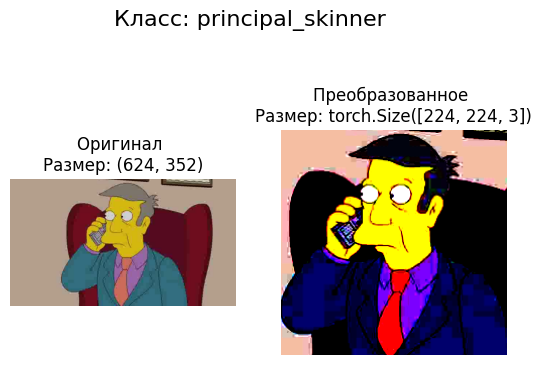

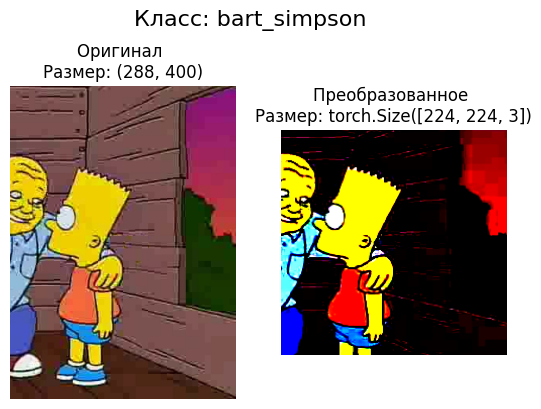

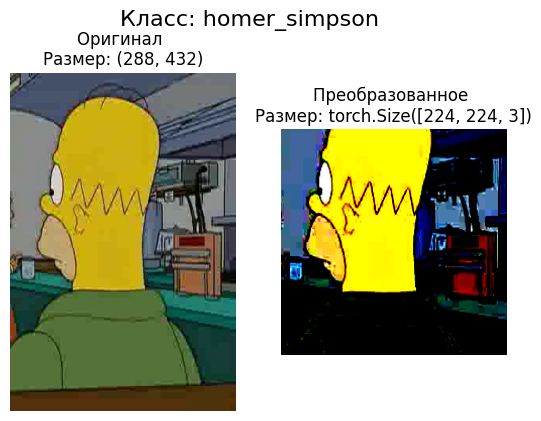

In [ ]:
# Выведем изображения до и после применения к ним преобразований
import random
import glob
from PIL import Image

def plot_transformed_images(image_paths, transform, n=3, seed=42):
    random.seed(seed)
    random_image_paths = random.sample(image_paths, k=n)
    for image_path in random_image_paths:
        with Image.open(image_path) as f:
            fig, ax = plt.subplots(1, 2)
            ax[0].imshow(f)
            ax[0].set_title(f"Оригинал \nРазмер: {f.size}")
            ax[0].axis("off")

            # преобразуем изображение, т.к. для PyTorch стандартным форматом является [C, H, W]
            # а для Matplotlib [H, W, C]
            transformed_image = transform(f).permute(1, 2, 0)
            ax[1].imshow(transformed_image)
            ax[1].set_title(f"Преобразованное \nРазмер: {transformed_image.shape}")
            ax[1].axis("off")

            fig.suptitle(f"Класс: {image_path.split('/')[-2]}", fontsize=16)


image_paths = glob.glob(f"{train_dir}/*/*.jpg")
plot_transformed_images(image_paths,
                        transform=transform,
                        n=3)

### Тюнинг модели

In [ ]:
# Посмотрим на архитектуру модели
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Посмотрим на полносвязный слой модели
model.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [ ]:
# количество дочерних слоев в модели
len(list(model.children()))

10

In [ ]:
# создаём модель
model = create_model(model, 8, 2048, num_classes)
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Обучение

In [ ]:
# обучение модели на оригинальных данных с замороженными 8-ю слоями

model_name = 'resnet50_basic_model'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)


resnet50_basic_model_f, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader_f,
                                                                      val_dataloader_f,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 0.8131 Acc: 0.7900
Train Loss: 1.171885524741744  Acc: 0.7026562201414103
Val Loss: 0.8130852022980589  Acc: 0.7900267481849446
Training time: 2.7752 minutes  Total: 2.7751666666666663 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 0.7428 Acc: 0.8198
Train Loss: 0.42987784602188045  Acc: 0.8803745461494362
Val Loss: 0.7428293299929398  Acc: 0.8198318685517768
Training time: 2.7115 minutes  Total: 5.486666666666666 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 0.7490 Acc: 0.8164
Train Loss: 0.2076066401682779  Acc: 0.9454742340276451
Val Loss: 0.7490279057472036  Acc: 0.8163928162017577
Training time: 2.7 minutes  Total: 8.186666666666666 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 0.7570 Acc: 0.8258
Train Loss: 0.11725287888457055  Acc: 0.972163832091216

Видно, что модель сильно переобучается. Точность 0.80, время обучения 27.5 мин.

In [ ]:
# обучение модели на изменённом наборе данных с замороженными 8-ю слоями

model_name = 'resnet50_basic_model'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)


resnet50_basic_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)


Epoch 1/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.8135 Acc: 0.7851
Train Loss: 1.2846166077741357  Acc: 0.6714202561117578
Val Loss: 0.8134769777864662  Acc: 0.7851123595505618
Training time: 2.456 minutes  Total: 2.4560000000000004 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.7609 Acc: 0.7931
Train Loss: 0.3882909437078376  Acc: 0.894790454016298
Val Loss: 0.7608822107092658  Acc: 0.7930711610486891
Training time: 2.3798 minutes  Total: 4.8358333333333325 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.6434 Acc: 0.8329
Train Loss: 0.16738759936808154  Acc: 0.9572176949941793
Val Loss: 0.6434382113780993  Acc: 0.8328651685393258
Training time: 2.3687 minutes  Total: 7.2044999999999995 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.6261 Acc: 0.8411
Train Loss: 0.08256604819190363  Acc: 0.98508440046

Модель также сильно переобучается, однако точность выше - 0.85, время обучения меньше - 24 мин. Оставим данную модель в качестве основной базовой модели

### Граффики ACC и Loss на трейне и валидации

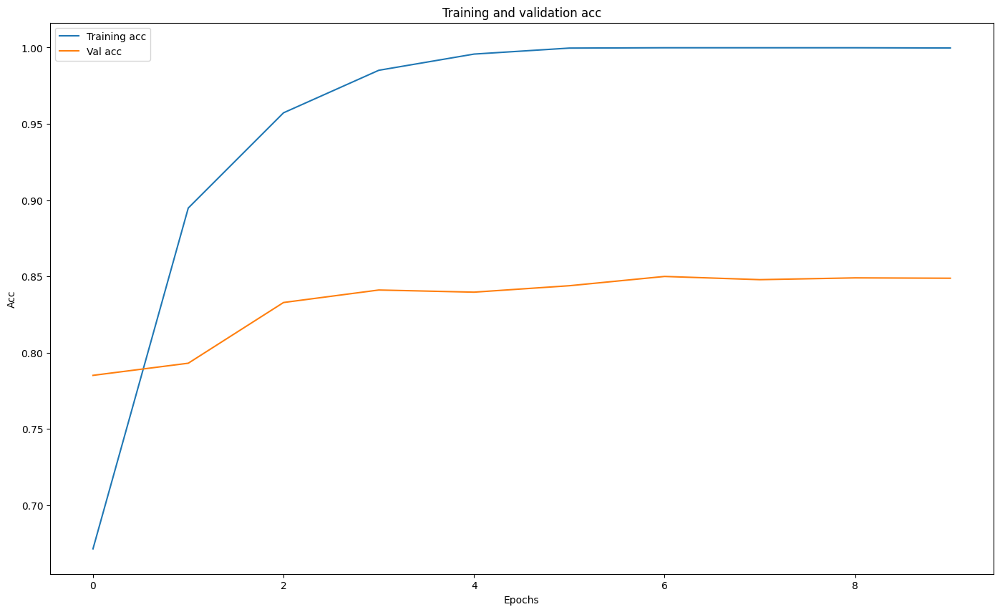

In [ ]:
visualization(train_acc, val_acc, is_loss = False)

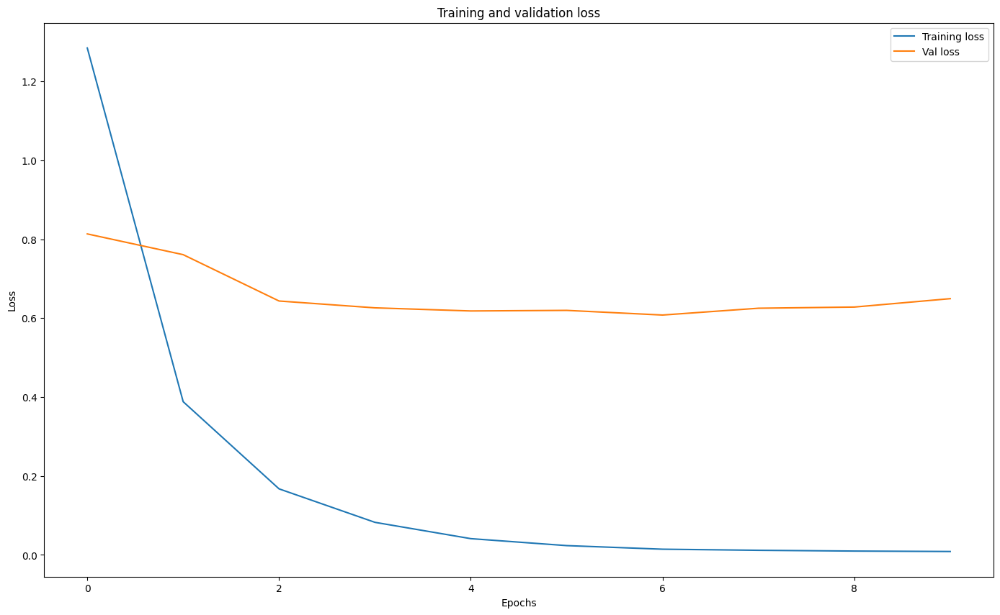

In [ ]:
visualization(train_loss, val_loss, is_loss = True)

In [ ]:
val_loss = val_loss[len(val_loss)-1]
val_acc = val_acc[len(val_acc)-1]

# Завершение таймера и вывод общего времени обучения
total_time = round(total_time / 60, 2)



# Создание временного датафрейма с данными
temp_df = pd.DataFrame({'name': [model_name],
                        'loss': [val_loss],
                        'acc': [val_acc],
                        'time': [total_time],
                        'learning_rate': [learning_rate],
                        'epochs': [num_epochs]})
# Объединение данных с помощью метода concat
models_df = pd.concat([models_df, temp_df], ignore_index=True)

models_df

,name,loss,acc,time,learning_rate,epochs
0,resnet50_basic_model,0.649371,0.848783,23.93,0.01,10


### Визуализация предсказаний на валидации

In [ ]:
example, _ = random_split(val_dataset, [9, len(val_dataset) - 9])
example_loader = torch.utils.data.DataLoader(example, batch_size=9)
model = resnet50_basic_model

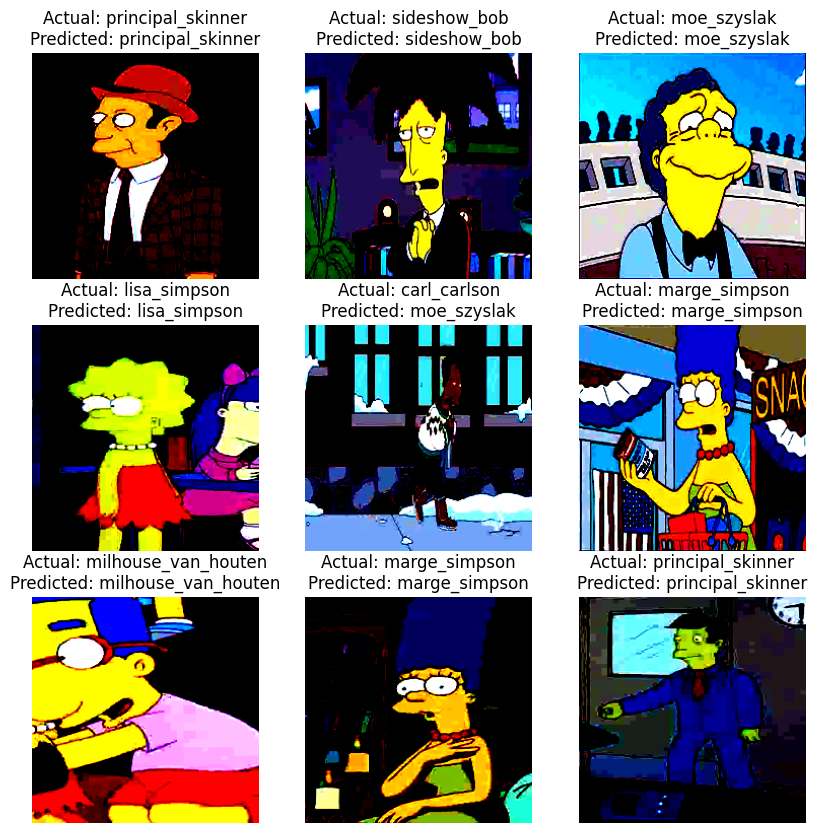

In [ ]:
# Выведем изображения с классами из валидации

# переводим модель в режим оценки
model.eval()

# получаем один батч из 9 картинок и меток
X, y = next(iter(example_loader))

# переводим батч на GPU
X, y = X.to(device), y.to(device)

# получаем предсказания модели для батча
pred = model(X)

# выбираем наиболее вероятный класс для каждой картинки
pred = torch.argmax(pred, dim=1)

# создаем фигуру с 9 подграфиками
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# итерируем по картинкам, меткам и предсказаниям
for i, (img, label, prediction) in enumerate(zip(X, y, pred)):
    # определяем координаты подграфика
    row = i // 3
    col = i % 3
    # отображаем картинку на подграфике
    axes[row, col].imshow(img.permute(1, 2, 0).cpu().squeeze())
    # добавляем заголовок с фактическим и прогнозным классом
    axes[row, col].set_title(f'Actual: {class_names[label.item()]}\nPredicted: {class_names[prediction.item()]}')
    # убираем оси координат
    axes[row, col].axis('off')

# показываем фигуру
plt.show()

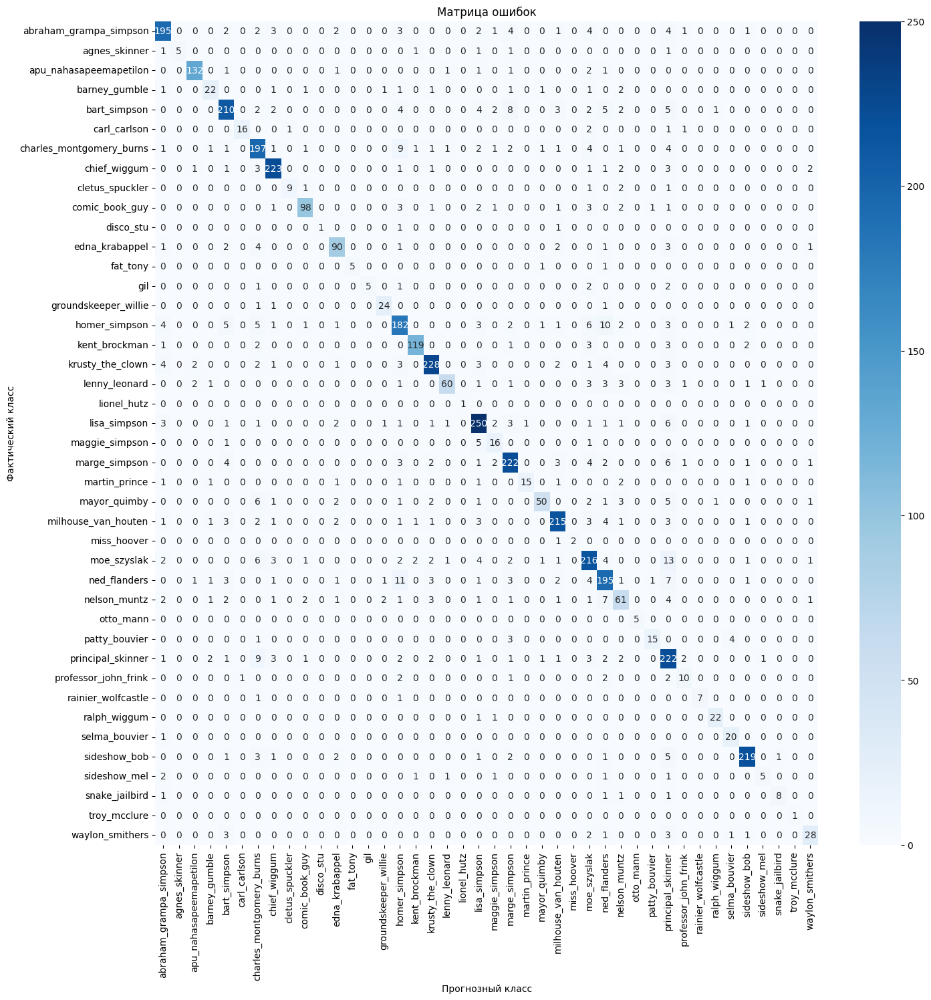

In [ ]:
# Матрица ошибок

# создаем список с названиями классов
class_names = train_dataset.label_encoder.classes_
# переводим модель в режим оценки
model.eval()

# создаем объект для вычисления confusion matrix
cm = ConfusionMatrix(task='multiclass', num_classes=num_classes).to(device)

# итерируем по всем батчам на тестовой выборке
for X, y in val_dataloader:
    # переводим батч на GPU
    X, y = X.to(device), y.to(device)
    # получаем предсказания модели для батча
    pred = torch.argmax(model(X), dim=1)
    # обновляем confusion matrix
    cm.update(pred, y)

# получаем confusion matrix в виде тензора
cm = cm.compute()

# создаем фигуру для отображения confusion matrix
plt.figure(figsize=(16, 16))

# используем функцию для визуализации confusion matrix с помощью Seaborn
sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Прогнозный класс')
plt.ylabel('Фактический класс')
plt.title('Матрица ошибок')

plt.show()

In [ ]:
from sklearn import metrics

# Установка модели в режим оценки (выключение режима обучения)
model.eval()

# Подготовка списков для предсказанных и истинных значений
y_pred = []
y_true = []

# Проход по валидационным данным и предсказываем значения
with torch.no_grad():
    for batch in val_dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)

        # Предсказание значений
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Представление предсказаний и истинных значений в виде массивов numpy
y_pred = np.array(y_pred)
y_true = np.array(y_true)

# Представление имен классов в отсортированном порядке
character_names = sorted(class_names)

# Создание матрицы ошибок (Confusion Matrix)
cnn_cm_simpsons = metrics.confusion_matrix(y_true, y_pred)

# Вычисление accuracy модели
cnn_accuracy_simpsons = metrics.accuracy_score(y_true, y_pred)

# Вывод отчета классификации
print(metrics.classification_report(y_true, y_pred, target_names=character_names))

# Вывод accuracy модели
print("Accuracy score: {}".format(cnn_accuracy_simpsons))

### Тест

In [ ]:
transform = models.ResNet50_Weights.DEFAULT.transforms()

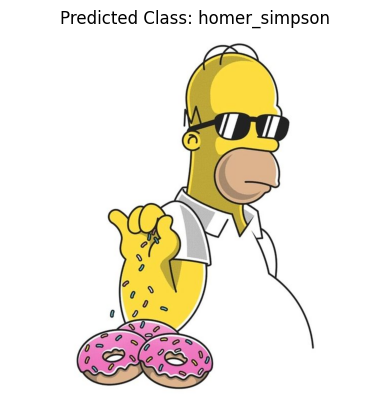

In [ ]:
url = 'https://i.pinimg.com/736x/77/5f/33/775f337a4afd8cbc83a20b5b5d66ee01.jpg'

classify_url_image(model, url, class_names)

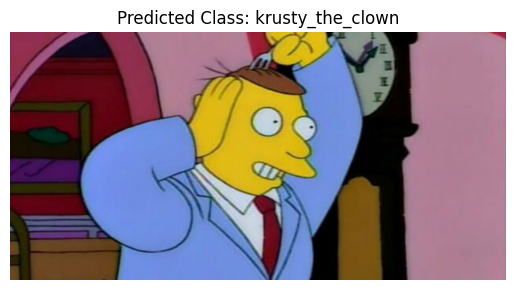

In [ ]:
# lionel_hutz
url = 'https://static1.srcdn.com/wordpress/wp-content/uploads/2019/10/Lionel-Hutz-in-The-Simpsons-5.jpg'

classify_url_image(model, url, class_names)

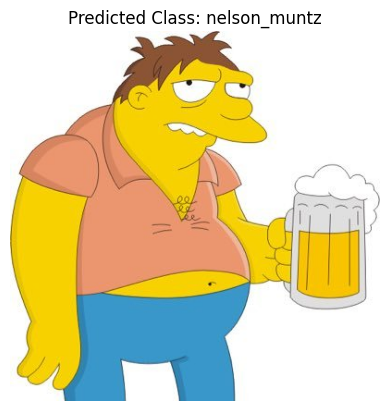

In [ ]:
# barney_gumble
url = 'https://pbs.twimg.com/profile_images/1106464941861756928/ih7F9SBC_400x400.jpg'

classify_url_image(model, url, class_names)

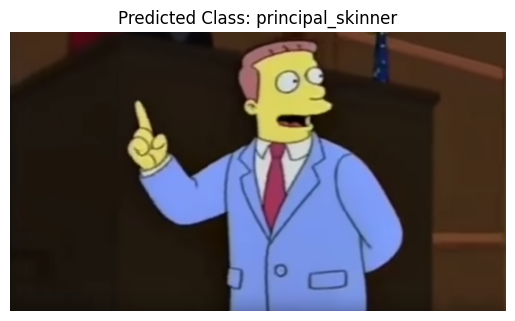

In [ ]:
# lionel_hutz
url = 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/aqiplqcyb4mhrrxzhdrh.png'

classify_url_image(model, url, class_names)

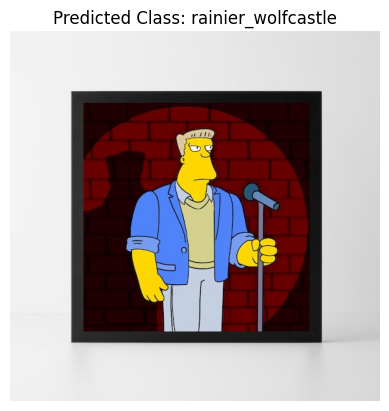

In [ ]:
# rainer_wolfcastle
url = 'https://i.etsystatic.com/32887768/r/il/9b9621/3684440590/il_570xN.3684440590_8wc4.jpg'

classify_url_image(model, url, class_names)

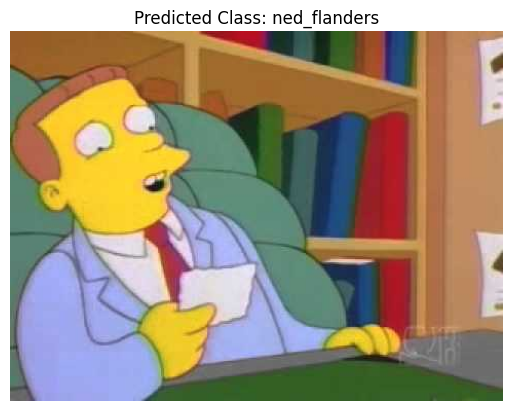

In [ ]:
# lionel_hutz
url = 'https://i.ytimg.com/vi/5yuL6PcgSgM/hqdefault.jpg'
classify_url_image(model, url, class_names)

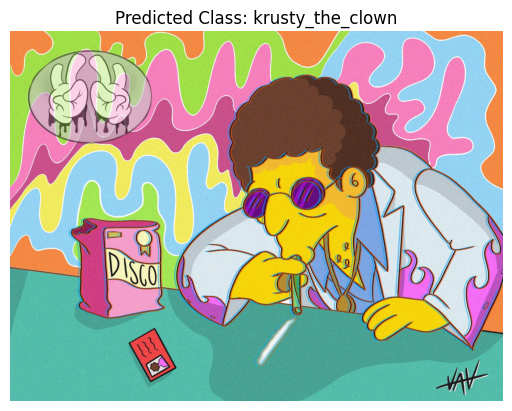

In [ ]:
# disco_stu
url = 'https://i.etsystatic.com/20846563/r/il/6e2be5/2271760966/il_fullxfull.2271760966_d54f.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# disco_stu
url = 'https://static.wikia.nocookie.net/simpsons/images/5/54/Future_Disco_Stu.png/revision/latest?cb=20141115003933'
classify_url_image(model, url, class_names)

UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x7d8d53b9e520>

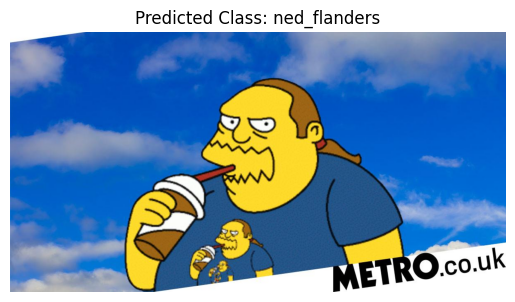

In [ ]:
# comic_book_guy
url = 'https://metro.co.uk/wp-content/uploads/2021/01/comic-guy-4248_1609771351.jpg?quality=90&strip=all&w=1200&h=630&crop=1'
classify_url_image(model, url, class_names)

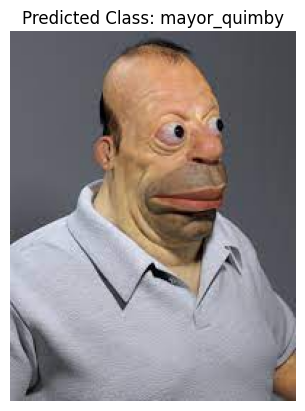

In [ ]:
url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTJVPRC4nQom1lI8ZHyeZinxgi26IeESAUJw28e1JLTD6qlIwEN_-VgSRaToozuumLtkRQ&usqp=CAU'
classify_url_image(model, url, class_names)

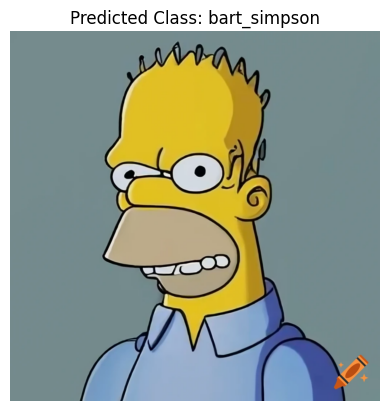

In [ ]:
url = 'https://pics.craiyon.com/2023-11-14/pVfMLZSkSVWDN8-F73CwYA.webp'
classify_url_image(model, url, class_names)

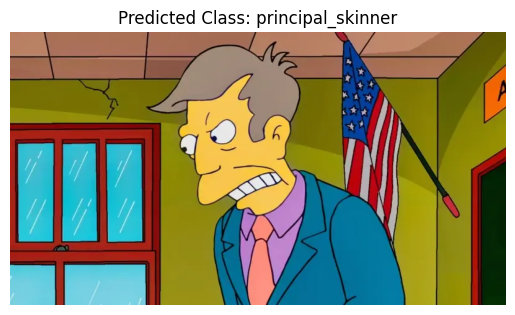

In [ ]:
# principal_skinner
url = 'https://a1cf74336522e87f135f-2f21ace9a6cf0052456644b80fa06d4f.ssl.cf2.rackcdn.com/images/characters/large/800/Principal-Skinner.The-Simpsons.webp'
classify_url_image(model, url, class_names)

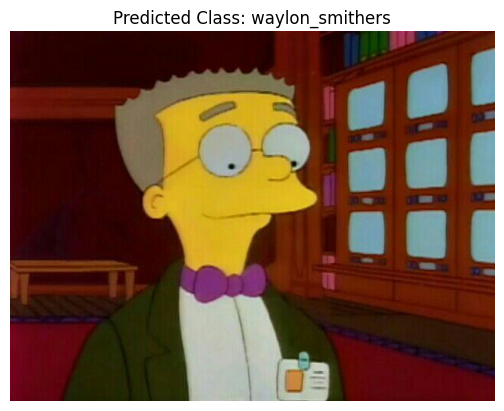

In [ ]:
# waylon_smithers
url = 'https://pm1.aminoapps.com/6624/e9358b3082184c87004984c3c39047d8754a1c1a_hq.jpg'
classify_url_image(model, url, class_names)

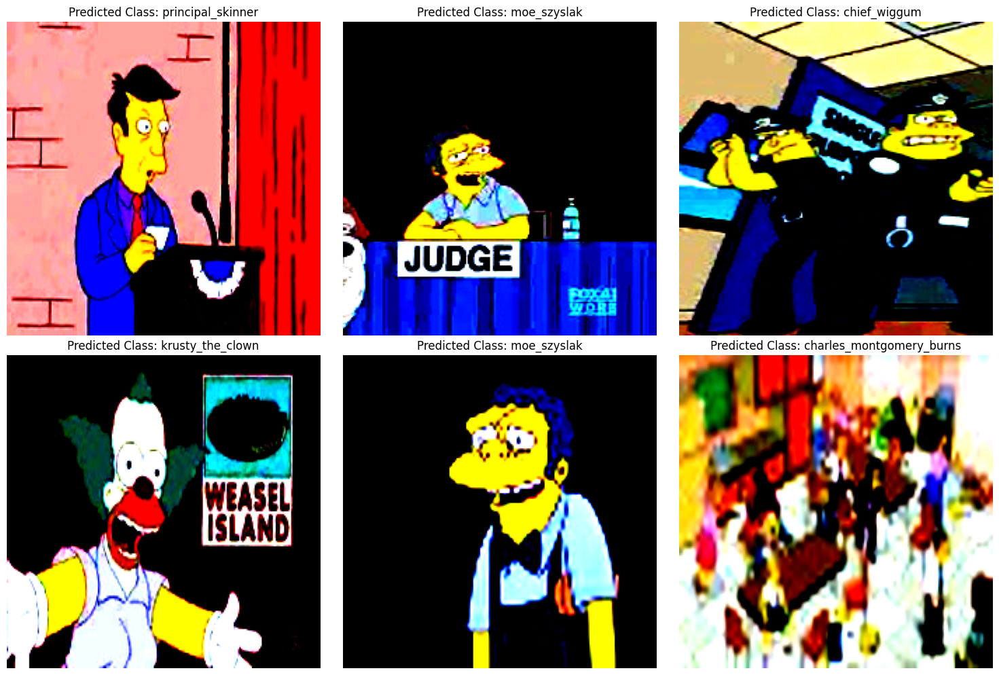

In [ ]:
# функция для классификации рандомных изображений в тестовом датасете

classify_random_images(model, test_dataset, class_names, 3, 2)  # В данном примере 2 строки с 3 изображениями в каждой

## Resnet50 без заморозки слоёв - Неудачный

### Загрузка модели, подготовка данных для передачи в модель

In [ ]:
from torchvision import datasets, models, transforms

# Для обучения будем использовать ResNet18
# Преобразуем данные для передачи в ResNet152
weights = models.ResNet50_Weights.DEFAULT
transform = weights.transforms()

In [ ]:
train_dataset.transform = transform
val_dataset.transform = transform
test_dataset.transform = transform

In [ ]:
# Ещё раз выведем количество данных в тренировачных и тестовых выборках
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

15699
5234
991


In [ ]:
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=32, shuffle=False)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([32, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


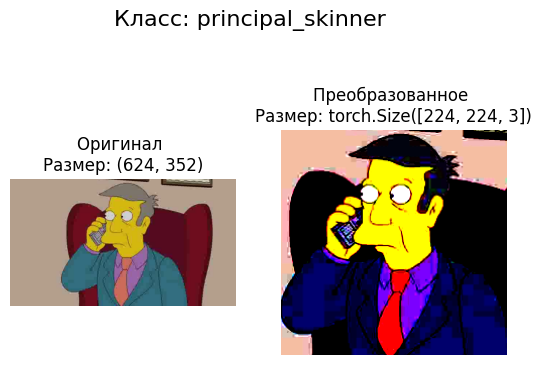

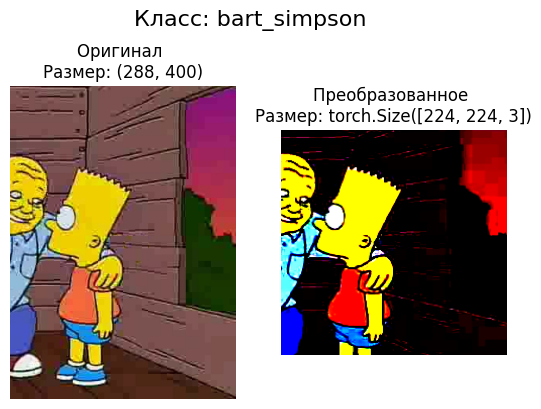

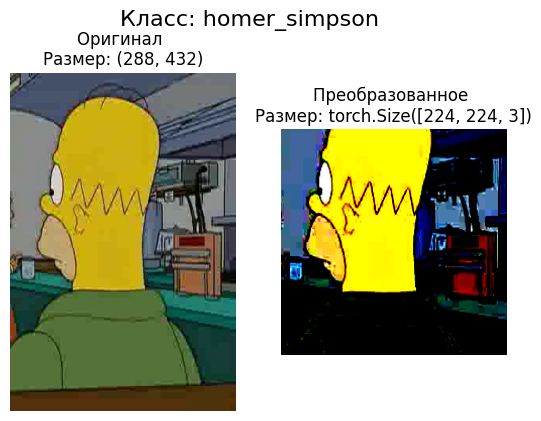

In [ ]:
# Выведем изображения до и после применения к ним преобразований
import random
import glob
from PIL import Image

def plot_transformed_images(image_paths, transform, n=3, seed=42):
    random.seed(seed)
    random_image_paths = random.sample(image_paths, k=n)
    for image_path in random_image_paths:
        with Image.open(image_path) as f:
            fig, ax = plt.subplots(1, 2)
            ax[0].imshow(f)
            ax[0].set_title(f"Оригинал \nРазмер: {f.size}")
            ax[0].axis("off")

            # преобразуем изображение, т.к. для PyTorch стандартным форматом является [C, H, W]
            # а для Matplotlib [H, W, C]
            transformed_image = transform(f).permute(1, 2, 0)
            ax[1].imshow(transformed_image)
            ax[1].set_title(f"Преобразованное \nРазмер: {transformed_image.shape}")
            ax[1].axis("off")

            fig.suptitle(f"Класс: {image_path.split('/')[-2]}", fontsize=16)


image_paths = glob.glob(f"{train_dir}/*/*.jpg")
plot_transformed_images(image_paths,
                        transform=transform,
                        n=3)

### Тюнинг модели

In [ ]:
import torchvision.models as models

model = models.resnet50(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 108MB/s]


In [ ]:
# Посмотрим на архитектуру модели
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Посмотрим на полносвязный слой модели
model.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [ ]:
# количество дочерних слоев в модели
len(list(model.children()))

10

In [ ]:
# Получение количества входных признаков последнего слоя модели
num_ftrs = model.fc.in_features
num_ftrs

2048

In [ ]:
# Замена последнего слоя модели на новый линейный слой с заданным числом выходных классов
model.fc = nn.Linear(num_ftrs, num_classes)

# Перемещение модели на устройство
model = model.to(device)

model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Обучение

In [ ]:
# обучение модели

model_name = 'resnet50_full_model'
learning_rate = 0.1
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)


resnet50_model_notfrozen, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)


Epoch 1/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 3.1319 Acc: 0.1074
Train Loss: 3.2030958803996534  Acc: 0.09771323014204726
Val Loss: 3.13192286287866  Acc: 0.10737485670615209
Training time: 5.2745 minutes  Total: 5.274500000000001 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 1196254.0570 Acc: 0.0491
Train Loss: 3.54741269436188e+19  Acc: 0.06267915153831455
Val Loss: 1196254.0569740853  Acc: 0.04910202521971723
Training time: 4.499 minutes  Total: 9.773500000000002 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 29546.3795 Acc: 0.0665
Train Loss: 247911.97245735742  Acc: 0.06382572138352761
Val Loss: 29546.37947194169  Acc: 0.06648834543370272
Training time: 4.9355 minutes  Total: 14.709000000000001 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 8263.4627 Acc: 0.0718
Train Loss: 15900.592746587003  Acc

KeyboardInterrupt: 

Обучение оказалось не успешным.

### Граффики ACC и Loss на трейне и валидации

In [ ]:
visualization(train_acc, val_acc, is_loss = False)

In [ ]:
visualization(train_loss, val_loss, is_loss = True)

In [ ]:
val_loss = val_loss[len(val_loss)-1]
val_acc = val_acc[len(val_acc)-1]

# Завершение таймера и вывод общего времени обучения
total_time = round(total_time / 60, 2)



# Создание временного датафрейма с данными
temp_df = pd.DataFrame({'name': [model_name],
                        'loss': [val_loss],
                        'acc': [val_acc],
                        'time': [total_time],
                        'learning_rate': [learning_rate],
                        'epochs': [num_epochs]})
# Объединение данных с помощью метода concat
models_df = pd.concat([models_df, temp_df], ignore_index=True)

models_df

### Визуализация предсказаний на валидации

In [ ]:
example, _ = random_split(val_dataset, [9, len(val_dataset) - 9])
example_loader = torch.utils.data.DataLoader(example, batch_size=9)
model = resnet50_basic_model

In [ ]:
# Выведем изображения с классами из валидации

# переводим модель в режим оценки
model.eval()

# получаем один батч из 9 картинок и меток
X, y = next(iter(example_loader))

# переводим батч на GPU
X, y = X.to(device), y.to(device)

# получаем предсказания модели для батча
pred = model(X)

# выбираем наиболее вероятный класс для каждой картинки
pred = torch.argmax(pred, dim=1)

# создаем фигуру с 9 подграфиками
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# итерируем по картинкам, меткам и предсказаниям
for i, (img, label, prediction) in enumerate(zip(X, y, pred)):
    # определяем координаты подграфика
    row = i // 3
    col = i % 3
    # отображаем картинку на подграфике
    axes[row, col].imshow(img.permute(1, 2, 0).cpu().squeeze())
    # добавляем заголовок с фактическим и прогнозным классом
    axes[row, col].set_title(f'Actual: {class_names[label.item()]}\nPredicted: {class_names[prediction.item()]}')
    # убираем оси координат
    axes[row, col].axis('off')

# показываем фигуру
plt.show()

In [ ]:
# Матрица ошибок

# создаем список с названиями классов
class_names = train_dataset.label_encoder.classes_
# переводим модель в режим оценки
model.eval()

# создаем объект для вычисления confusion matrix
cm = ConfusionMatrix(task='multiclass', num_classes=num_classes).to(device)

# итерируем по всем батчам на тестовой выборке
for X, y in val_dataloader:
    # переводим батч на GPU
    X, y = X.to(device), y.to(device)
    # получаем предсказания модели для батча
    pred = torch.argmax(model(X), dim=1)
    # обновляем confusion matrix
    cm.update(pred, y)

# получаем confusion matrix в виде тензора
cm = cm.compute()

# создаем фигуру для отображения confusion matrix
plt.figure(figsize=(16, 16))

# используем функцию для визуализации confusion matrix с помощью Seaborn
sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Прогнозный класс')
plt.ylabel('Фактический класс')
plt.title('Матрица ошибок')

plt.show()

In [ ]:
from sklearn import metrics

# Установка модели в режим оценки (выключение режима обучения)
model.eval()

# Подготовка списков для предсказанных и истинных значений
y_pred = []
y_true = []

# Проход по валидационным данным и предсказываем значения
with torch.no_grad():
    for batch in val_dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)

        # Предсказание значений
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Представление предсказаний и истинных значений в виде массивов numpy
y_pred = np.array(y_pred)
y_true = np.array(y_true)

# Представление имен классов в отсортированном порядке
character_names = sorted(class_names)

# Создание матрицы ошибок (Confusion Matrix)
cnn_cm_simpsons = metrics.confusion_matrix(y_true, y_pred)

# Вычисление accuracy модели
cnn_accuracy_simpsons = metrics.accuracy_score(y_true, y_pred)

# Вывод отчета классификации
print(metrics.classification_report(y_true, y_pred, target_names=character_names))

# Вывод accuracy модели
print("Accuracy score: {}".format(cnn_accuracy_simpsons))

### Тест

In [ ]:
transform = models.ResNet50_Weights.DEFAULT.transforms()

In [ ]:
url = 'https://i.pinimg.com/736x/77/5f/33/775f337a4afd8cbc83a20b5b5d66ee01.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# lionel_hutz
url = 'https://static1.srcdn.com/wordpress/wp-content/uploads/2019/10/Lionel-Hutz-in-The-Simpsons-5.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# barney_gumble
url = 'https://pbs.twimg.com/profile_images/1106464941861756928/ih7F9SBC_400x400.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# lionel_hutz
url = 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/aqiplqcyb4mhrrxzhdrh.png'

classify_url_image(model, url, class_names)

In [ ]:
# rainer_wolfcastle
url = 'https://i.etsystatic.com/32887768/r/il/9b9621/3684440590/il_570xN.3684440590_8wc4.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# lionel_hutz
url = 'https://i.ytimg.com/vi/5yuL6PcgSgM/hqdefault.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# disco_stu
url = 'https://i.etsystatic.com/20846563/r/il/6e2be5/2271760966/il_fullxfull.2271760966_d54f.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# disco_stu
url = 'https://static.wikia.nocookie.net/simpsons/images/5/54/Future_Disco_Stu.png/revision/latest?cb=20141115003933'
classify_url_image(model, url, class_names)

In [ ]:
# comic_book_guy
url = 'https://metro.co.uk/wp-content/uploads/2021/01/comic-guy-4248_1609771351.jpg?quality=90&strip=all&w=1200&h=630&crop=1'
classify_url_image(model, url, class_names)

In [ ]:
url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTJVPRC4nQom1lI8ZHyeZinxgi26IeESAUJw28e1JLTD6qlIwEN_-VgSRaToozuumLtkRQ&usqp=CAU'
classify_url_image(model, url, class_names)

In [ ]:
url = 'https://pics.craiyon.com/2023-11-14/pVfMLZSkSVWDN8-F73CwYA.webp'
classify_url_image(model, url, class_names)

In [ ]:
# principal_skinner
url = 'https://a1cf74336522e87f135f-2f21ace9a6cf0052456644b80fa06d4f.ssl.cf2.rackcdn.com/images/characters/large/800/Principal-Skinner.The-Simpsons.webp'
classify_url_image(model, url, class_names)

In [ ]:
# waylon_smithers
url = 'https://pm1.aminoapps.com/6624/e9358b3082184c87004984c3c39047d8754a1c1a_hq.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# функция для классификации рандомных изображений в тестовом датасете

classify_random_images(model, test_dataset, class_names, 3, 2)  # В данном примере 2 строки с 3 изображениями в каждой

## Resnet152 73%

#### Загрузка модели, подготовка данных для передачи в модель

Выполним преобразование и аугментацию данных для использования с моделью ResNet-152.



In [ ]:
# Преобразуем данные для передачи в ResNet152
weights = models.ResNet152_Weights.DEFAULT
transform = weights.transforms()

In [ ]:
train_dataset.transform = transform
val_dataset.transform = transform
test_dataset.transform = transform

In [ ]:
# Ещё раз выведем количество данных в тренировачных и тестовых выборках
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

13744
4255
991


In [ ]:
# Создаём даталоадеры
train_dataloader = torch.utils.data.DataLoader(train_dataset,
                                    batch_size=32,
                                    shuffle=True)

val_dataloader = torch.utils.data.DataLoader(val_dataset,
                                    batch_size=32,
                                    shuffle=False)

test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                    batch_size=32,
                                    shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([32, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


### Тюнинг модели

Испльзуем модель без заморозки слоёв, с заморозкой модель сильнее переобучается

In [ ]:
import torchvision.models as models

model = models.resnet152(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:02<00:00, 99.1MB/s]


In [ ]:
# Посмотрим на архитектуру модели ResNet50
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Посмотрим на полносвязный слой модели
model.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [ ]:
len(list(model.children()))

10

In [ ]:
# model = create_model(model, 8, 2048, num_classes)

In [ ]:
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Получение количества входных признаков последнего слоя модели
num_ftrs = model.fc.in_features

# Замена последнего слоя модели на новый линейный слой с заданным числом выходных классов
model.fc = nn.Linear(num_ftrs, num_classes)

# Перемещение модели на устройство
model = model.to(device)

model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Обучение

In [ ]:
# обучение модели без заморозки слоёв


model_name = 'resnet152_model'
learning_rate = 0.1
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)


resnet152_model_base, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)


Epoch 1/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 20.6860 Acc: 0.5314
Train Loss: 38.126248135677606  Acc: 0.43968277066356226
Val Loss: 20.686034041687957  Acc: 0.5313748531139836
Training time: 3.6078 minutes  Total: 3.6078333333333332 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 24.3820 Acc: 0.5800
Train Loss: 19.05687049655027  Acc: 0.6180878928987195
Val Loss: 24.382033837735094  Acc: 0.5800235017626322
Training time: 3.6802 minutes  Total: 7.287999999999999 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 22.0936 Acc: 0.6345
Train Loss: 19.240677208401436  Acc: 0.6562863795110594
Val Loss: 22.09361689365504  Acc: 0.6345475910693302
Training time: 3.5498 minutes  Total: 10.837833333333332 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 25.7592 Acc: 0.6381
Train Loss: 16.602046556528226  Acc: 0.702124563

### Граффики ACC и Loss на трейне и валидации

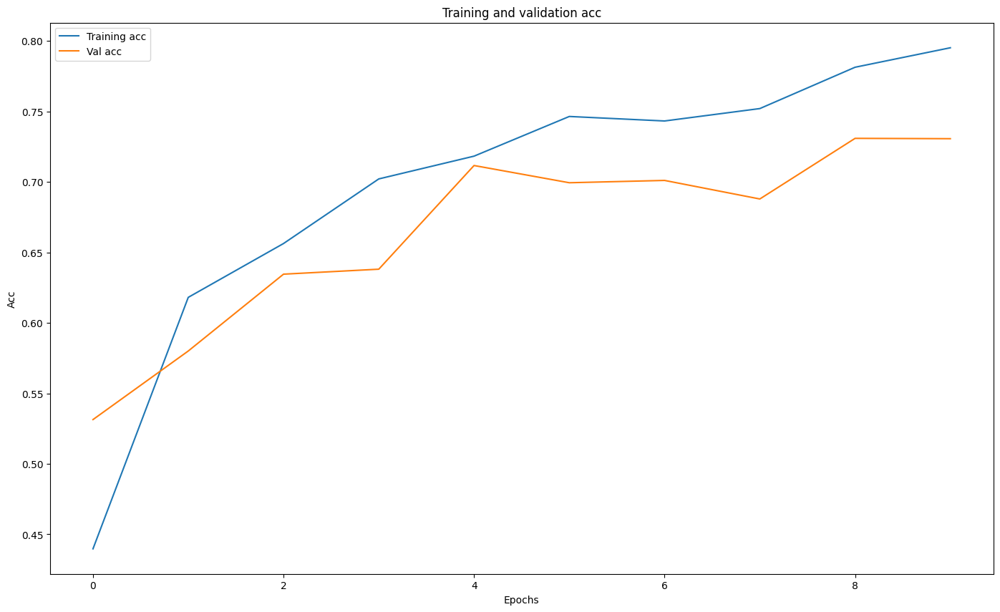

In [ ]:
visualization(train_acc, val_acc, is_loss = False)

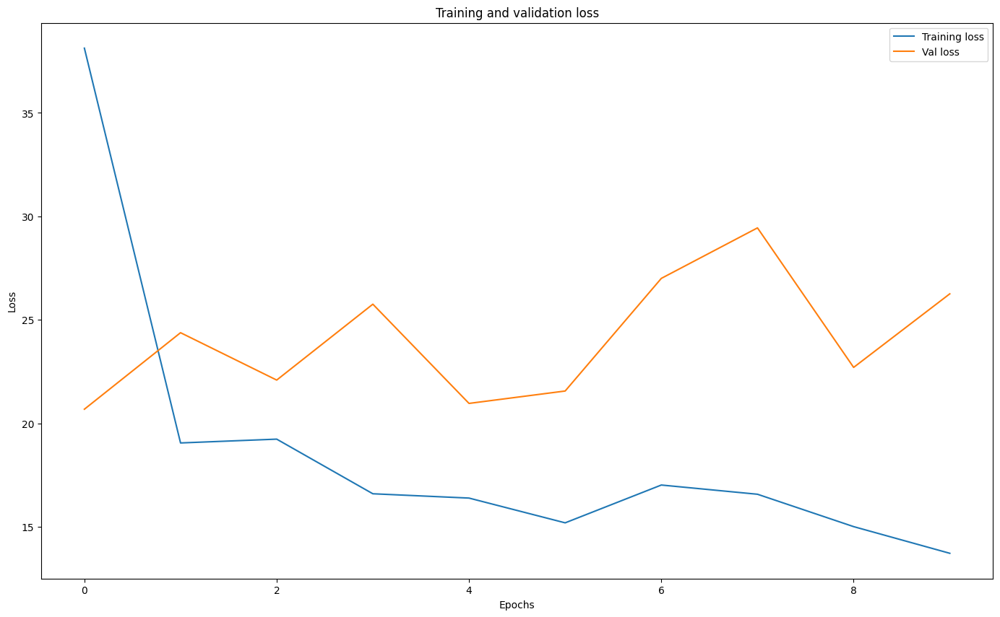

In [ ]:
visualization(train_loss, val_loss, is_loss = True)

Видно, что с увеличением эпох точность на трейне и валидации увеличивается волнообразно, функция потерь на трейне падает, но на валидации начинает возрастать. Можно попробовать продолжить обучение модели, вполне возможно с увеличением количества эпох точность на тренировке и валидации выровняется и станет выше. Пока на данный момент, точность модели низкая и модель переобучается

In [ ]:
val_loss = val_loss[len(val_loss)-1]
val_acc = val_acc[len(val_acc)-1]
total_time = round(total_time / 60, 2)



# Создание временного датафрейма с данными
temp_df = pd.DataFrame({'name': [model_name],
                        'loss': [val_loss],
                        'acc': [val_acc],
                        'time': [total_time],
                        'learning_rate': [learning_rate],
                        'epochs': [num_epochs]})
# Объединение данных с помощью метода concat
models_df = pd.concat([models_df, temp_df], ignore_index=True)

models_df

,name,loss,acc,time,learning_rate,epochs
0,resnet152_model,26.259433,0.73067,36.09,0.1,10


### Визуализация предсказаний на валидации

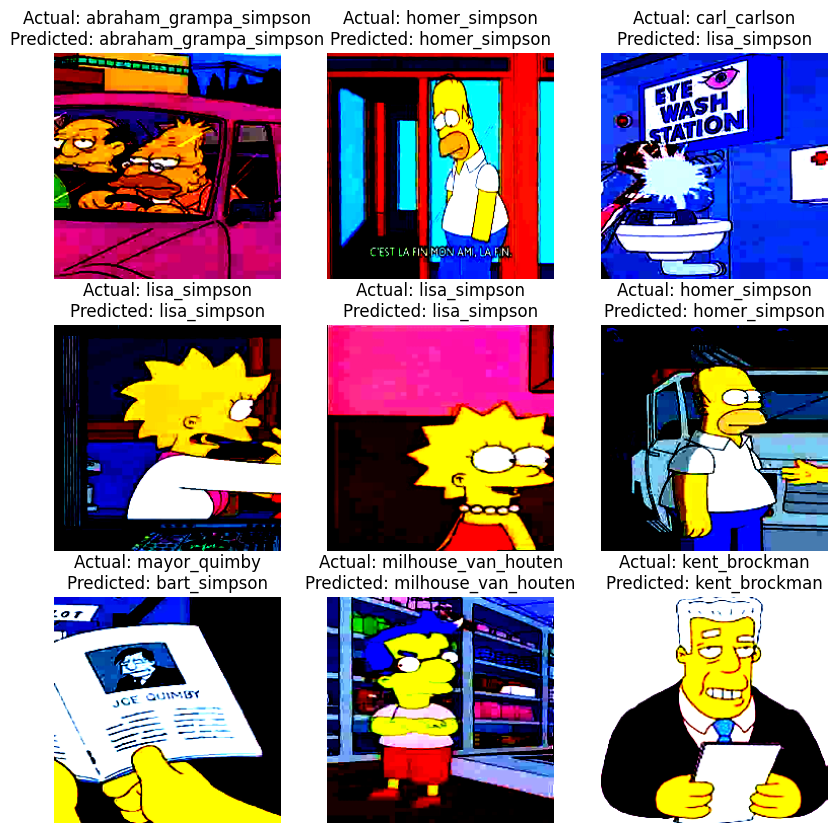

In [ ]:
# Выведем изображения с классами из валидации

model = resnet152_model_base

example, _ = random_split(val_dataset, [9, len(val_dataset) - 9])
example_loader = torch.utils.data.DataLoader(example, batch_size=9)


# переводим модель в режим оценки
model.eval()

# получаем один батч из 9 картинок и меток
X, y = next(iter(example_loader))

# переводим батч на GPU
X, y = X.to(device), y.to(device)

# получаем предсказания модели для батча
pred = model(X)

# выбираем наиболее вероятный класс для каждой картинки
pred = torch.argmax(pred, dim=1)

# создаем фигуру с 9 подграфиками
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# итерируем по картинкам, меткам и предсказаниям
for i, (img, label, prediction) in enumerate(zip(X, y, pred)):
    # определяем координаты подграфика
    row = i // 3
    col = i % 3
    # отображаем картинку на подграфике
    axes[row, col].imshow(img.permute(1, 2, 0).cpu().squeeze())
    # добавляем заголовок с фактическим и прогнозным классом
    axes[row, col].set_title(f'Actual: {class_names[label.item()]}\nPredicted: {class_names[prediction.item()]}')
    # убираем оси координат
    axes[row, col].axis('off')

# показываем фигуру
plt.show()

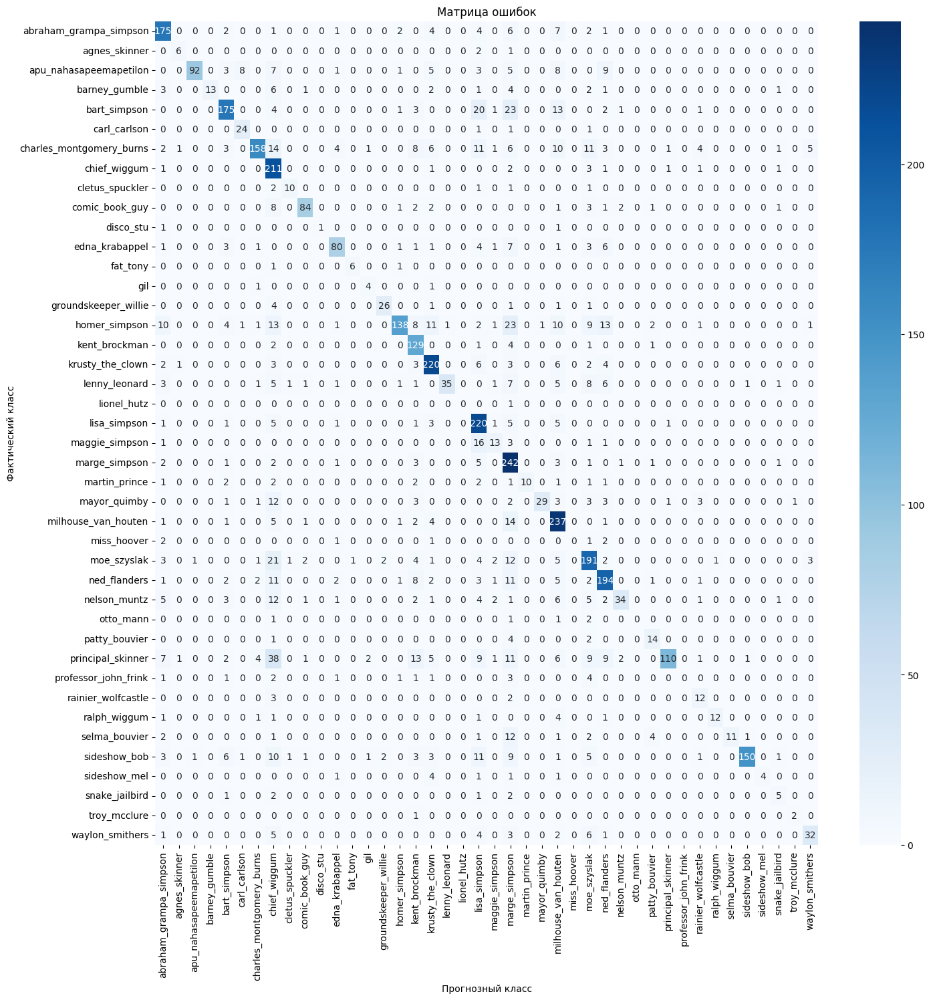

In [ ]:
# Матрица ошибок


# создаем список с названиями классов
class_names = train_dataset.label_encoder.classes_
# переводим модель в режим оценки
model.eval()

# создаем объект для вычисления confusion matrix
cm = ConfusionMatrix(task='multiclass', num_classes=num_classes).to(device)

# итерируем по всем батчам на тестовой выборке
for X, y in val_dataloader:
    # переводим батч на GPU
    X, y = X.to(device), y.to(device)
    # получаем предсказания модели для батча
    pred = torch.argmax(model(X), dim=1)
    # обновляем confusion matrix
    cm.update(pred, y)

# получаем confusion matrix в виде тензора
cm = cm.compute()

# создаем фигуру для отображения confusion matrix
plt.figure(figsize=(16, 16))

# используем функцию для визуализации confusion matrix с помощью Seaborn
sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Прогнозный класс')
plt.ylabel('Фактический класс')
plt.title('Матрица ошибок')

plt.show()

In [ ]:
from sklearn import metrics

# Установка модели в режим оценки (выключение режима обучения)
model.eval()

# Подготовка списков для предсказанных и истинных значений
y_pred = []
y_true = []

# Проход по валидационным данным и предсказываем значения
with torch.no_grad():
    for batch in val_dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)

        # Предсказание значений
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Представление предсказаний и истинных значений в виде массивов numpy
y_pred = np.array(y_pred)
y_true = np.array(y_true)

# Представление имен классов в отсортированном порядке
character_names = sorted(class_names)

# Создание матрицы ошибок (Confusion Matrix)
cnn_cm_simpsons = metrics.confusion_matrix(y_true, y_pred)

# Вычисление accuracy модели
cnn_accuracy_simpsons = metrics.accuracy_score(y_true, y_pred)

# Вывод отчета классификации
print(metrics.classification_report(y_true, y_pred, target_names=character_names))

# Вывод accuracy модели
print("Accuracy score: {}".format(cnn_accuracy_simpsons))

### Тест

In [ ]:
transform = models.ResNet152_Weights.DEFAULT.transforms()

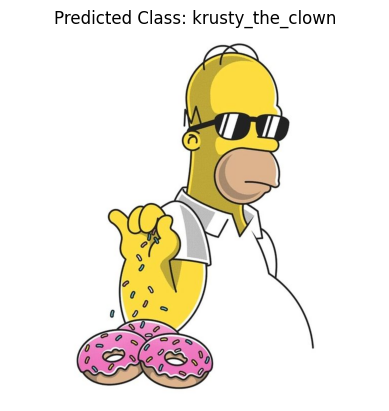

In [ ]:
url = 'https://i.pinimg.com/736x/77/5f/33/775f337a4afd8cbc83a20b5b5d66ee01.jpg'

classify_url_image(model, url, class_names)

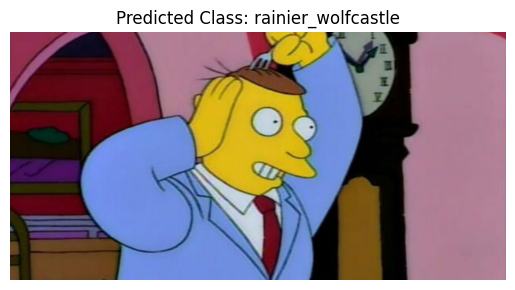

In [ ]:
# lionel_hutz
url = 'https://static1.srcdn.com/wordpress/wp-content/uploads/2019/10/Lionel-Hutz-in-The-Simpsons-5.jpg'

classify_url_image(model, url, class_names)

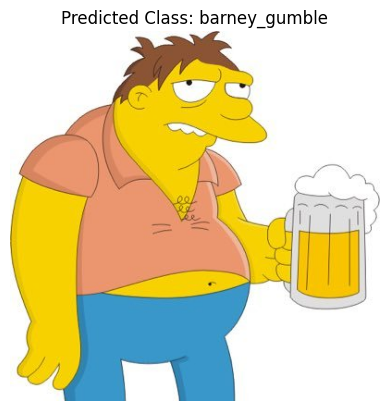

In [ ]:
# barney_gumble
url = 'https://pbs.twimg.com/profile_images/1106464941861756928/ih7F9SBC_400x400.jpg'

classify_url_image(model, url, class_names)

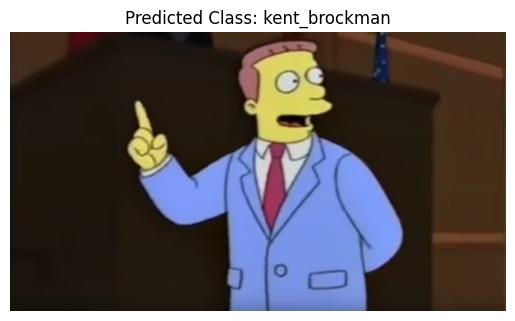

In [ ]:
# lionel_hutz
url = 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/aqiplqcyb4mhrrxzhdrh.png'

classify_url_image(model, url, class_names)

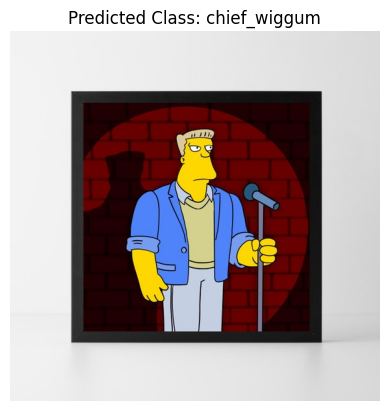

In [ ]:
# rainer_wolfcastle
url = 'https://i.etsystatic.com/32887768/r/il/9b9621/3684440590/il_570xN.3684440590_8wc4.jpg'

classify_url_image(model, url, class_names)

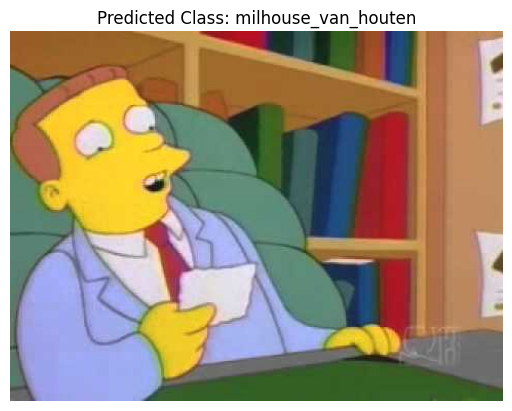

In [ ]:
# lionel_hutz
url = 'https://i.ytimg.com/vi/5yuL6PcgSgM/hqdefault.jpg'
classify_url_image(model, url, class_names)

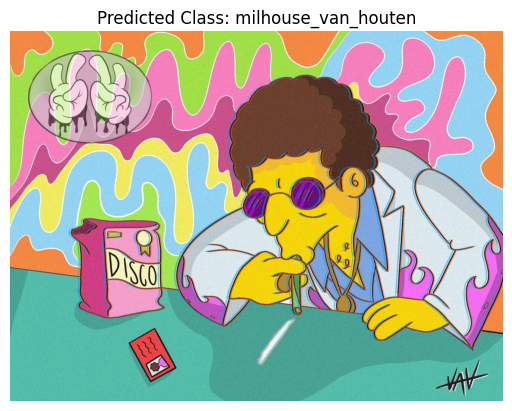

In [ ]:
# disco_stu
url = 'https://i.etsystatic.com/20846563/r/il/6e2be5/2271760966/il_fullxfull.2271760966_d54f.jpg'
classify_url_image(model, url, class_names)

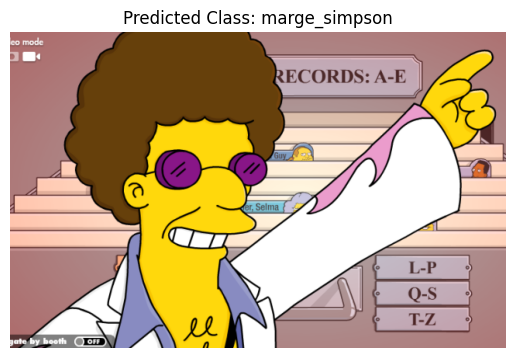

In [ ]:
# disco_stu
url = 'https://static.wikia.nocookie.net/simpsons/images/5/54/Future_Disco_Stu.png/revision/latest?cb=20141115003933'
classify_url_image(model, url, class_names)

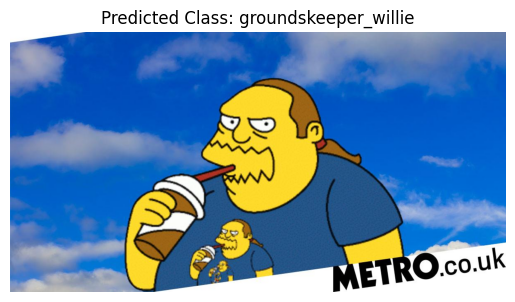

In [ ]:
# comic_book_guy
url = 'https://metro.co.uk/wp-content/uploads/2021/01/comic-guy-4248_1609771351.jpg?quality=90&strip=all&w=1200&h=630&crop=1'
classify_url_image(model, url, class_names)

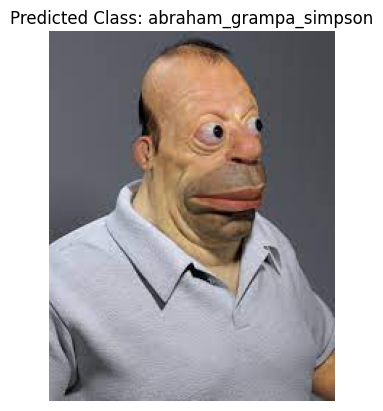

In [ ]:
url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTJVPRC4nQom1lI8ZHyeZinxgi26IeESAUJw28e1JLTD6qlIwEN_-VgSRaToozuumLtkRQ&usqp=CAU'
classify_url_image(model, url, class_names)

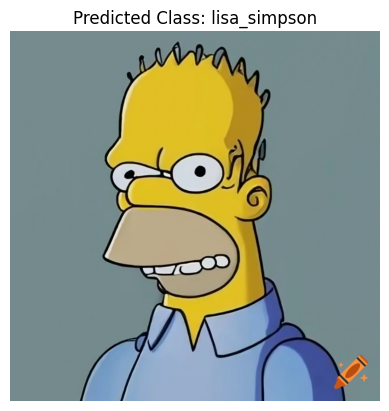

In [ ]:
url = 'https://pics.craiyon.com/2023-11-14/pVfMLZSkSVWDN8-F73CwYA.webp'
classify_url_image(model, url, class_names)

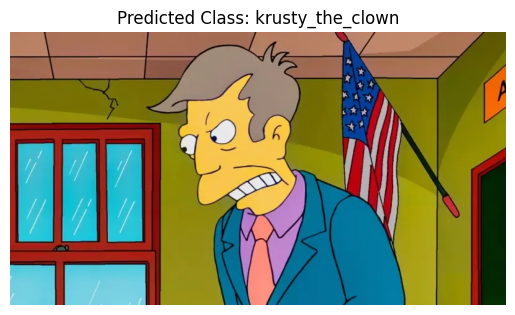

In [ ]:
# principal_skinner
url = 'https://a1cf74336522e87f135f-2f21ace9a6cf0052456644b80fa06d4f.ssl.cf2.rackcdn.com/images/characters/large/800/Principal-Skinner.The-Simpsons.webp'
classify_url_image(model, url, class_names)

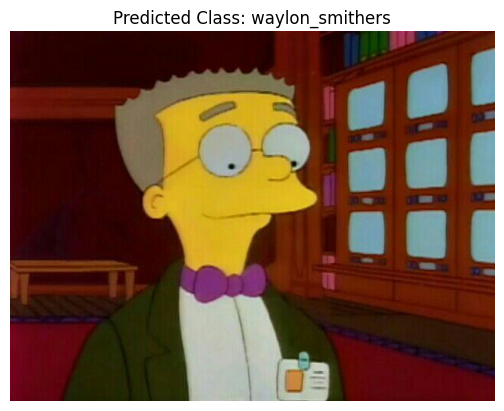

In [ ]:
# waylon_smithers
url = 'https://pm1.aminoapps.com/6624/e9358b3082184c87004984c3c39047d8754a1c1a_hq.jpg'
classify_url_image(model, url, class_names)

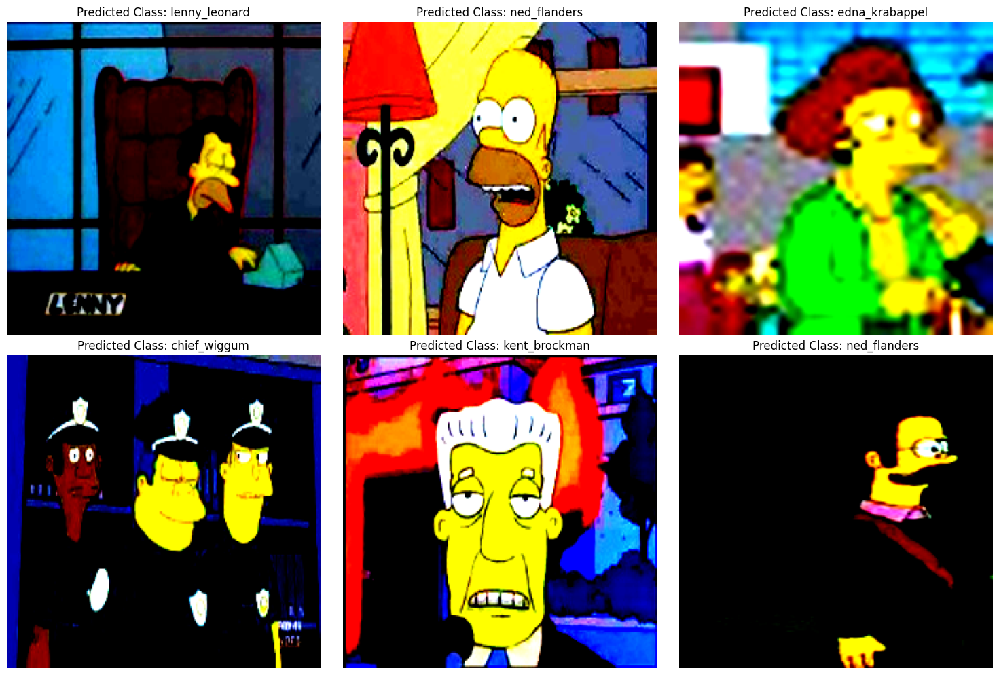

In [ ]:
# функция для классификации рандомных изображений в тестовом датасете

classify_random_images(model, test_dataset, class_names, 3, 2)  # В данном примере 2 строки с 3 изображениями в каждой

## Resnet152 97%

#### Загрузка модели, подготовка данных для передачи в модель

Выполним преобразование данных для использования в модели ResNet-152.



In [ ]:
# Преобразуем данные для передачи в ResNet152
weights = models.ResNet152_Weights.DEFAULT
transform = weights.transforms()

In [ ]:
train_dataset.transform = transform
val_dataset.transform = transform
test_dataset.transform = transform

In [ ]:
# Ещё раз выведем количество данных в тренировачных и тестовых выборках
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

13744
4272
991


In [ ]:
# Создаём даталоадеры
train_dataloader = torch.utils.data.DataLoader(train_dataset,
                                    batch_size=32,
                                    shuffle=True)

val_dataloader = torch.utils.data.DataLoader(val_dataset,
                                    batch_size=32,
                                    shuffle=False)

test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                    batch_size=32,
                                    shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([32, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


### Тюнинг модели

In [ ]:
import torchvision.models as models

model = models.resnet152(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
# Посмотрим на архитектуру модели ResNet50
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Посмотрим на полносвязный слой модели
model.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [ ]:
# Получение количества входных признаков последнего слоя модели
num_ftrs = model.fc.in_features

# Замена последнего слоя модели на новый линейный слой с заданным числом выходных классов
model.fc = nn.Linear(num_ftrs, num_classes)

# Перемещение модели на устройство
model = model.to(device)

model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Обучение

Гиперпараметры (learning_rate, оптимизатор SGD, momentum=0.9, nesterov=True) подобраны на основе похожих работ с Kaggle, данные параметры встречались в некоторых работах, и давали точность около 94-95%. Из-за SGD оптимизатора модель сходится очень медленно, поэтому выбрано малое количество эпох, однако точность модели получается очень высокая.

In [ ]:
# обучение модели без заморозки


model_name = 'resnet152_model'
learning_rate = 0.001
num_epochs=4
momentum=0.9

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum=momentum, nesterov=True)


resnet152_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)


Epoch 1/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.3413 Acc: 0.9284
Train Loss: 1.3844056589312332  Acc: 0.6872817229336438
Val Loss: 0.3412932956090836  Acc: 0.9283707865168539
Training time: 7.4608 minutes  Total: 7.4608333333333325 minutes
-----------------

Epoch 2/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.2234 Acc: 0.9419
Train Loss: 0.3151930978532534  Acc: 0.9182188591385332
Val Loss: 0.22338326906190478  Acc: 0.9419475655430711
Training time: 7.1725 minutes  Total: 14.633333333333333 minutes
-----------------

Epoch 3/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.1848 Acc: 0.9581
Train Loss: 0.12573792314763332  Acc: 0.965221187427241
Val Loss: 0.18479258691414413  Acc: 0.9580992509363296
Training time: 7.2408 minutes  Total: 21.874166666666667 minutes
-----------------

Epoch 4/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.1469 Acc: 0.9684
Train Loss: 0.06214780376638288  Acc: 0.983338183934

Попробуем продолжить обучение модели

In [ ]:
# продолжение обучения модели


model_name = 'resnet152_model'
learning_rate = 0.001
weight_decay = 1e-2
num_epochs=4
momentum=0.9

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum=momentum, nesterov=True)


resnet152_model, train_loss, train_acc, val_loss, val_acc, total_time = train(resnet152_model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.0955 Acc: 0.9780
Train Loss: 0.1024614690694698  Acc: 0.989522700814901
Val Loss: 0.09554576996797279  Acc: 0.977996254681648
Training time: 7.5143 minutes  Total: 7.514333333333334 minutes
-----------------

Epoch 2/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.1314 Acc: 0.9728
Train Loss: 0.01865350941811865  Acc: 0.9955616996507567
Val Loss: 0.13137025879363232  Acc: 0.9728464419475655
Training time: 7.4313 minutes  Total: 14.945666666666666 minutes
-----------------

Epoch 3/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.1472 Acc: 0.9672
Train Loss: 0.028326651888422677  Acc: 0.9916327124563445
Val Loss: 0.1471963788124772  Acc: 0.9672284644194756
Training time: 7.302 minutes  Total: 22.247666666666667 minutes
-----------------

Epoch 4/4:
Evaluating... [██████████████████████████████] 133/133 Loss: 0.1632 Acc: 0.9616
Train Loss: 0.024536507237997624  Acc: 0.992942374854

Данная модель показала лучшую точность - 0.968 на валидации, по итогу 4 эпох обучения, время обучения 29 минут. Дальнейшее обучение привело к улучшению до 0.977 на 5-ой эпохе, далее точность немного упала.

Сохраним модель на диск

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/resnet152_model.pth'

In [ ]:
torch.save(resnet152_model.state_dict(), path)

### Граффики ACC и Loss на трейне и валидации

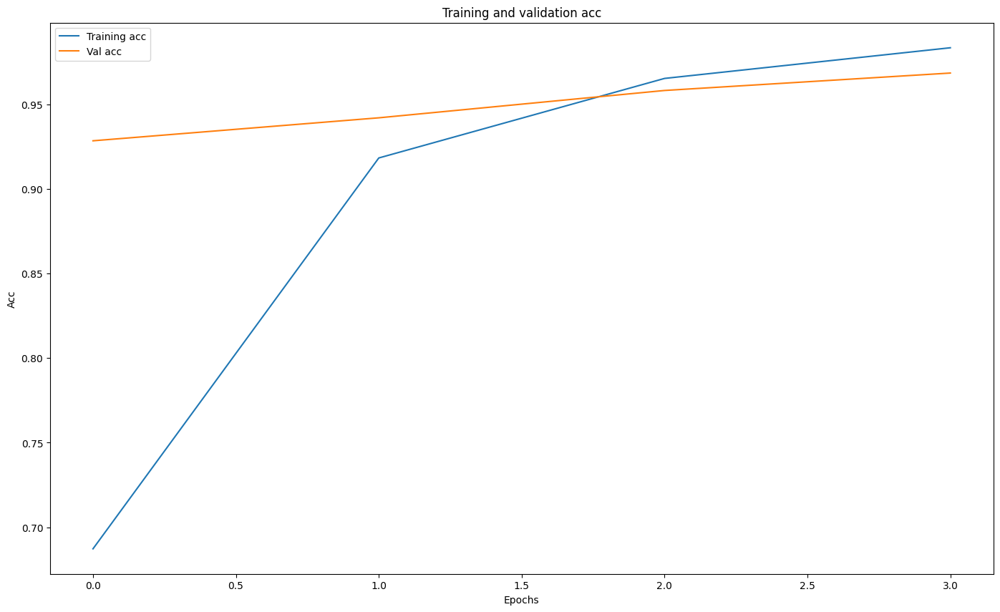

In [ ]:
visualization(train_acc, val_acc, is_loss = False)

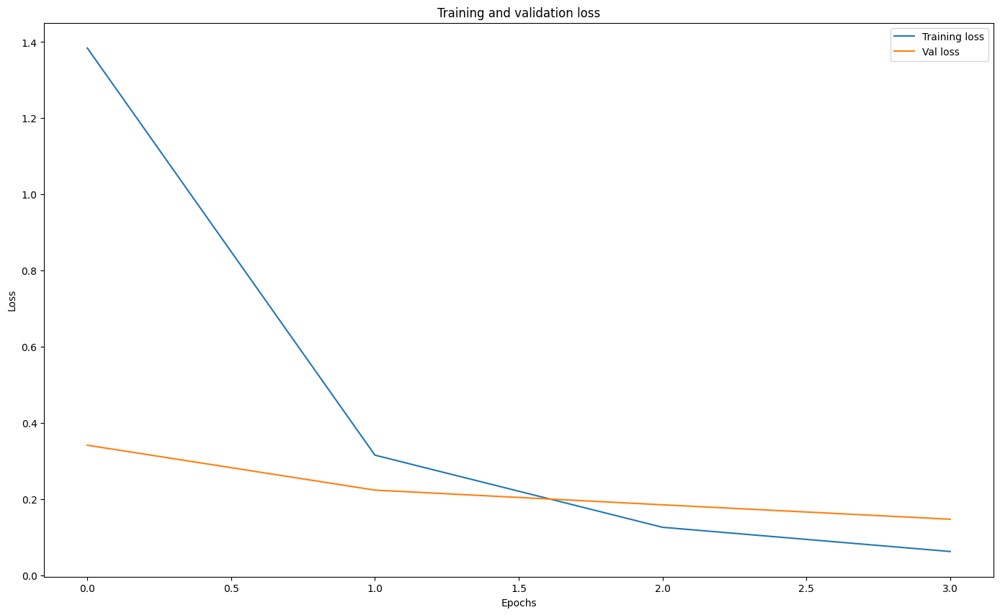

In [ ]:
visualization(train_loss, val_loss, is_loss = True)

In [ ]:
val_acc

0.9683988764044944

In [ ]:
# Завершение таймера и вывод общего времени обучения
total_time = round(total_time / 60, 2)



# Создание временного датафрейма с данными
temp_df = pd.DataFrame({'name': [model_name],
                        'loss': [val_loss],
                        'acc': [val_acc],
                        'time': [total_time],
                        'learning_rate': [learning_rate],
                        'epochs': [num_epochs]})
# Объединение данных с помощью метода concat
models_df = pd.concat([models_df, temp_df], ignore_index=True)

models_df

,name,loss,acc,time,learning_rate,epochs
0,resnet50_basic_model,0.649371,0.848783,23.93,0.010,10
1,resnet152_model,2.523912,0.733146,36.84,0.010,10
2,resnet152_model,0.146912,0.968399,29.07,0.001,4
3,resnet152_model,0.146912,0.968399,0.48,0.001,4


### Визуализация предсказаний на валидации

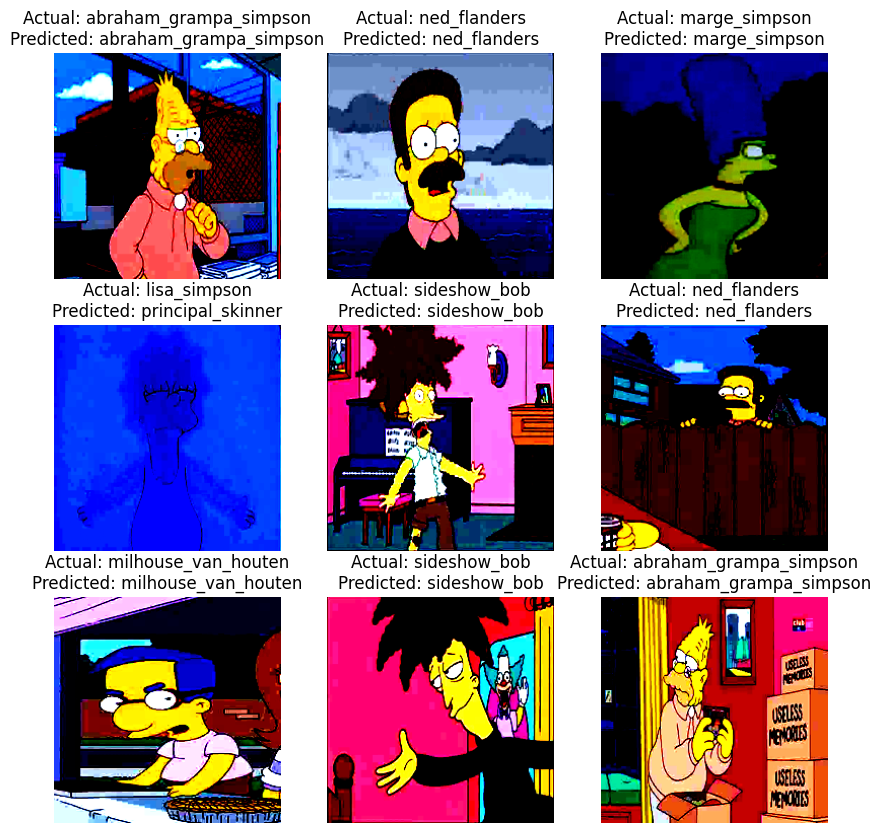

In [ ]:
# Выведем изображения с классами из валидации

model = resnet152_model

example, _ = random_split(val_dataset, [9, len(val_dataset) - 9])
example_loader = torch.utils.data.DataLoader(example, batch_size=9)


# переводим модель в режим оценки
model.eval()

# получаем один батч из 9 картинок и меток
X, y = next(iter(example_loader))

# переводим батч на GPU
X, y = X.to(device), y.to(device)

# получаем предсказания модели для батча
pred = model(X)

# выбираем наиболее вероятный класс для каждой картинки
pred = torch.argmax(pred, dim=1)

# создаем фигуру с 9 подграфиками
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# итерируем по картинкам, меткам и предсказаниям
for i, (img, label, prediction) in enumerate(zip(X, y, pred)):
    # определяем координаты подграфика
    row = i // 3
    col = i % 3
    # отображаем картинку на подграфике
    axes[row, col].imshow(img.permute(1, 2, 0).cpu().squeeze())
    # добавляем заголовок с фактическим и прогнозным классом
    axes[row, col].set_title(f'Actual: {class_names[label.item()]}\nPredicted: {class_names[prediction.item()]}')
    # убираем оси координат
    axes[row, col].axis('off')

# показываем фигуру
plt.show()

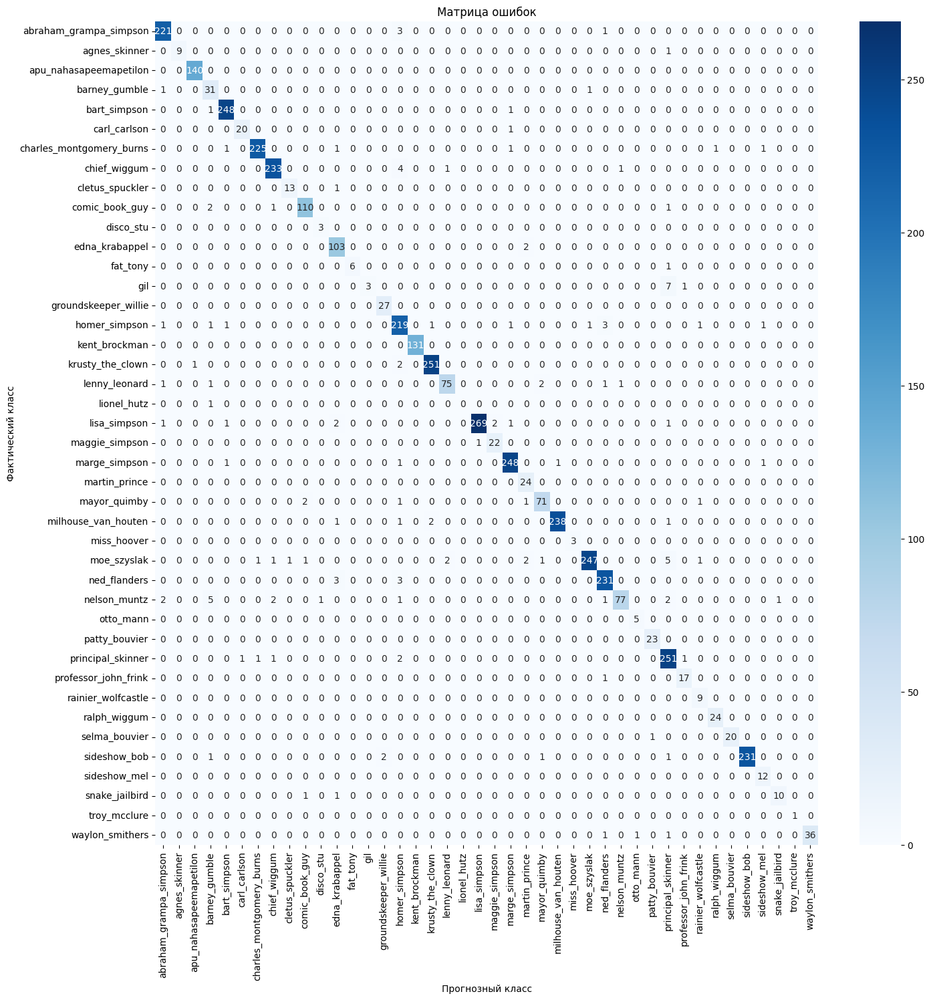

In [ ]:
# Матрица ошибок


# создаем список с названиями классов
class_names = train_dataset.label_encoder.classes_
# переводим модель в режим оценки
model.eval()

# создаем объект для вычисления confusion matrix
cm = ConfusionMatrix(task='multiclass', num_classes=num_classes).to(device)

# итерируем по всем батчам на тестовой выборке
for X, y in val_dataloader:
    # переводим батч на GPU
    X, y = X.to(device), y.to(device)
    # получаем предсказания модели для батча
    pred = torch.argmax(model(X), dim=1)
    # обновляем confusion matrix
    cm.update(pred, y)

# получаем confusion matrix в виде тензора
cm = cm.compute()

# создаем фигуру для отображения confusion matrix
plt.figure(figsize=(16, 16))

# используем функцию для визуализации confusion matrix с помощью Seaborn
sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Прогнозный класс')
plt.ylabel('Фактический класс')
plt.title('Матрица ошибок')

plt.show()

In [ ]:
from sklearn import metrics

# Установка модели в режим оценки (выключение режима обучения)
model.eval()

# Подготовка списков для предсказанных и истинных значений
y_pred = []
y_true = []

# Проход по валидационным данным и предсказываем значения
with torch.no_grad():
    for batch in val_dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)

        # Предсказание значений
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Представление предсказаний и истинных значений в виде массивов numpy
y_pred = np.array(y_pred)
y_true = np.array(y_true)

# Представление имен классов в отсортированном порядке
character_names = sorted(class_names)

# Создание матрицы ошибок (Confusion Matrix)
cnn_cm_simpsons = metrics.confusion_matrix(y_true, y_pred)

# Вычисление accuracy модели
cnn_accuracy_simpsons = metrics.accuracy_score(y_true, y_pred)

# Вывод отчета классификации
print(metrics.classification_report(y_true, y_pred, target_names=character_names))

# Вывод accuracy модели
print("Accuracy score: {}".format(cnn_accuracy_simpsons))

                          precision    recall  f1-score   support

  abraham_grampa_simpson       1.00      0.95      0.97       225
           agnes_skinner       1.00      0.90      0.95        10
  apu_nahasapeemapetilon       0.97      1.00      0.99       140
           barney_gumble       0.91      0.91      0.91        33
            bart_simpson       1.00      0.88      0.94       250
            carl_carlson       0.95      0.90      0.93        21
charles_montgomery_burns       0.95      0.99      0.97       230
            chief_wiggum       0.97      0.99      0.98       239
         cletus_spuckler       1.00      0.93      0.96        14
          comic_book_guy       0.96      0.96      0.96       114
               disco_stu       0.75      1.00      0.86         3
          edna_krabappel       0.94      0.98      0.96       105
                fat_tony       1.00      1.00      1.00         7
                     gil       1.00      0.45      0.62        11
    groun

Хуже всего модель предсказала класс:
- 'gil' f1-score 0.61. Чаще всего модель его путала в principal_skiner;


### Тест

In [ ]:
transform = models.ResNet152_Weights.DEFAULT.transforms()

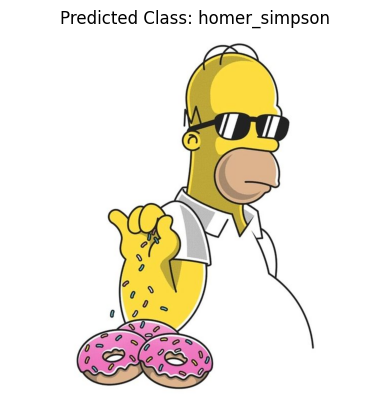

In [ ]:
url = 'https://i.pinimg.com/736x/77/5f/33/775f337a4afd8cbc83a20b5b5d66ee01.jpg'

classify_url_image(model, url, class_names)

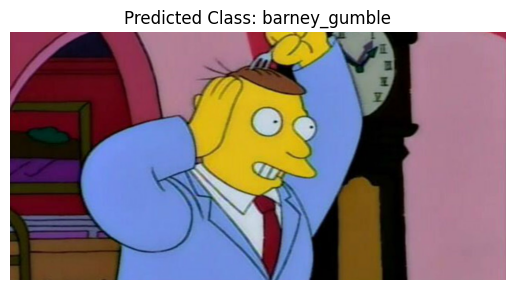

In [ ]:
# lionel_hutz
url = 'https://static1.srcdn.com/wordpress/wp-content/uploads/2019/10/Lionel-Hutz-in-The-Simpsons-5.jpg'

classify_url_image(model, url, class_names)

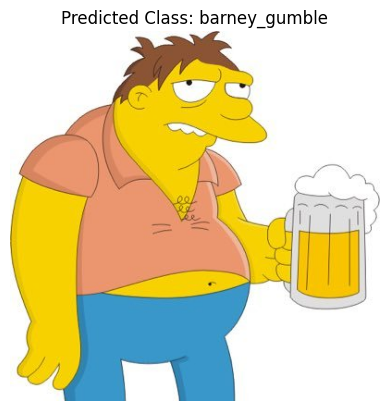

In [ ]:
# barney_gumble
url = 'https://pbs.twimg.com/profile_images/1106464941861756928/ih7F9SBC_400x400.jpg'

classify_url_image(model, url, class_names)

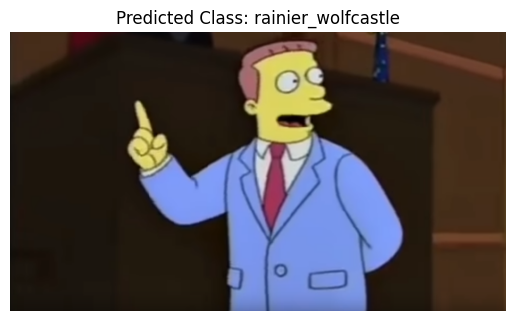

In [ ]:
# lionel_hutz
url = 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/aqiplqcyb4mhrrxzhdrh.png'

classify_url_image(model, url, class_names)

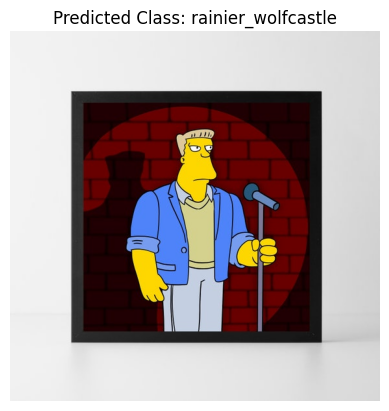

In [ ]:
# rainer_wolfcastle
url = 'https://i.etsystatic.com/32887768/r/il/9b9621/3684440590/il_570xN.3684440590_8wc4.jpg'

classify_url_image(model, url, class_names)

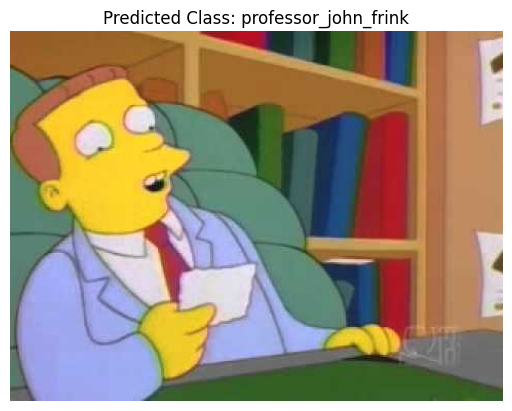

In [ ]:
# lionel_hutz
url = 'https://i.ytimg.com/vi/5yuL6PcgSgM/hqdefault.jpg'
classify_url_image(model, url, class_names)

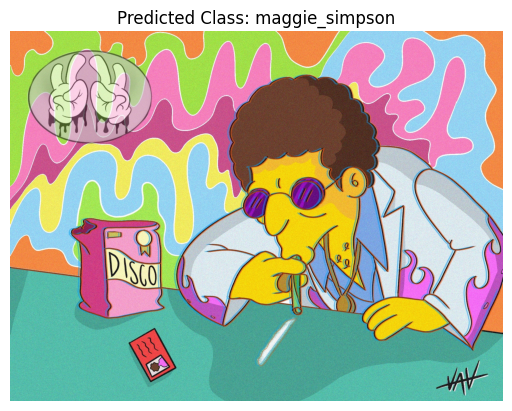

In [ ]:
# disco_stu
url = 'https://i.etsystatic.com/20846563/r/il/6e2be5/2271760966/il_fullxfull.2271760966_d54f.jpg'
classify_url_image(model, url, class_names)

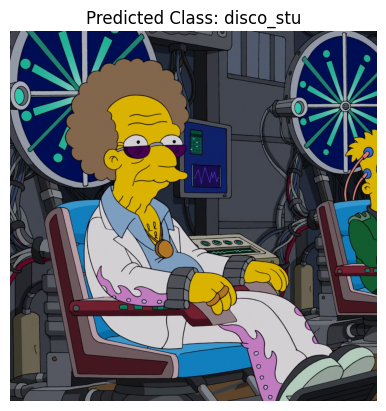

In [ ]:
# disco_stu
url = 'https://static.wikia.nocookie.net/simpsons/images/5/54/Future_Disco_Stu.png/revision/latest?cb=20141115003933'
classify_url_image(model, url, class_names)

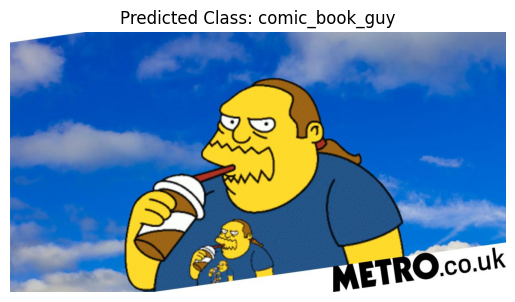

In [ ]:
# comic_book_guy
url = 'https://metro.co.uk/wp-content/uploads/2021/01/comic-guy-4248_1609771351.jpg?quality=90&strip=all&w=1200&h=630&crop=1'
classify_url_image(model, url, class_names)

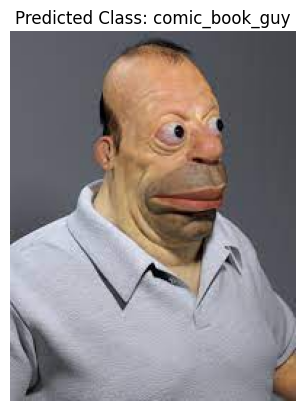

In [ ]:
url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTJVPRC4nQom1lI8ZHyeZinxgi26IeESAUJw28e1JLTD6qlIwEN_-VgSRaToozuumLtkRQ&usqp=CAU'
classify_url_image(model, url, class_names)

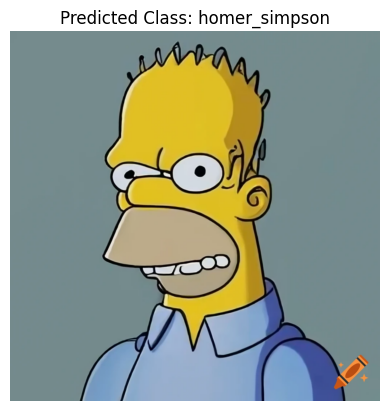

In [ ]:
url = 'https://pics.craiyon.com/2023-11-14/pVfMLZSkSVWDN8-F73CwYA.webp'
classify_url_image(model, url, class_names)

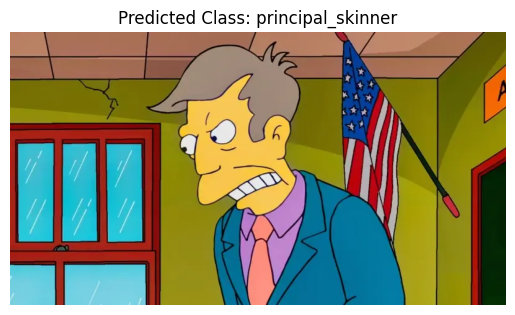

In [ ]:
# principal_skinner
url = 'https://a1cf74336522e87f135f-2f21ace9a6cf0052456644b80fa06d4f.ssl.cf2.rackcdn.com/images/characters/large/800/Principal-Skinner.The-Simpsons.webp'
classify_url_image(model, url, class_names)

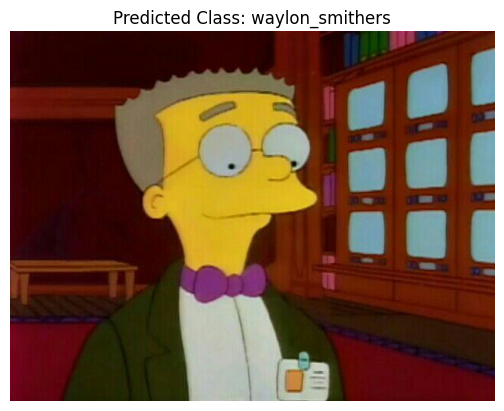

In [ ]:
# waylon_smithers
url = 'https://pm1.aminoapps.com/6624/e9358b3082184c87004984c3c39047d8754a1c1a_hq.jpg'
classify_url_image(model, url, class_names)

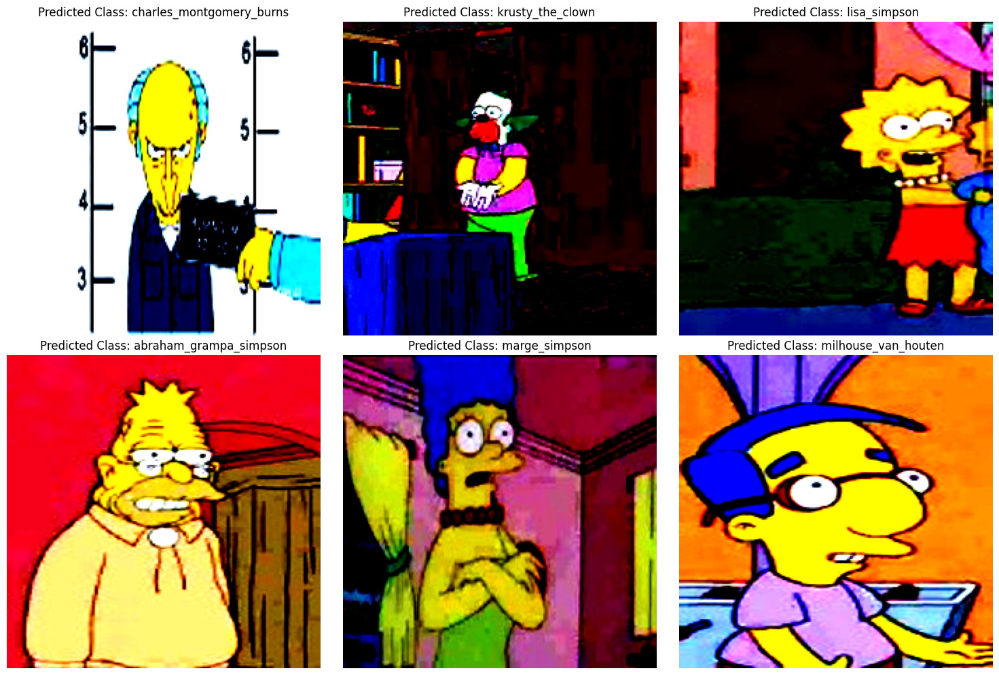

In [ ]:
# функция для классификации рандомных изображений в тестовом датасете

classify_random_images(model, test_dataset, class_names, 3, 2)  # В данном примере 2 строки с 3 изображениями в каждой

Как видно из тестов, модель дастоточно точно определяет персонажей, изображений которых было достаточно для обучения, но если попробовать передать персонажа более человечного вида, то модель ошибается.
Чтобы повысить точность предсказания в мало представленных классах необходимо увеличить количество данных для обучения.

In [ ]:
# # Сохранение обученной модели в файл
# resnet18_basic = torch.save(model.state_dict(), 'trained_model.pth')


# model.load_state_dict(torch.load('trained_model.pth'))
# model.eval()  # Переключение модели в режим evaluation

In [ ]:
# Сохранение обученной модели в файл
torch.save(model.state_dict(), 'trained_model_resnet152(96).pth')

## Resnet152 96% обучение на оригинальных данных

#### Загрузка модели, подготовка данных для передачи в модель

Выполним преобразование и аугментацию данных для использования с моделью ResNet-152.



In [ ]:
# Преобразуем данные для передачи в ResNet152
weights = models.ResNet152_Weights.DEFAULT
transform = weights.transforms()

In [ ]:
train_dataset.transform = transform
val_dataset.transform = transform
test_dataset.transform = transform

In [ ]:
# Ещё раз выведем количество данных в тренировачных и тестовых выборках
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

15699
5234
991


In [ ]:
# Создаём даталоадеры
train_dataloader = torch.utils.data.DataLoader(train_dataset,
                                    batch_size=64,
                                    shuffle=True)

val_dataloader = torch.utils.data.DataLoader(val_dataset,
                                    batch_size=64,
                                    shuffle=False)

test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                    batch_size=64,
                                    shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([64, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


### Тюнинг модели

In [ ]:
import torchvision.models as models

model = models.resnet152(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:02<00:00, 90.5MB/s]


In [ ]:
# Посмотрим на архитектуру модели ResNet50
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Посмотрим на полносвязный слой модели
model.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [ ]:
# Получение количества входных признаков последнего слоя модели
num_ftrs = model.fc.in_features

# Замена последнего слоя модели на новый линейный слой с заданным числом выходных классов
model.fc = nn.Linear(num_ftrs, num_classes)

# Перемещение модели на устройство
model = model.to(device)

model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Обучение

In [ ]:
# обучение модели


model_name = 'resnet152_model'
learning_rate = 0.001
weight_decay = 1e-2
num_epochs=4
momentum=0.9

loss_fn = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum=momentum, nesterov=True)


resnet152_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader_f,
                                                                      val_dataloader_f,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)


Epoch 1/4:
Evaluating... [██████████████████████████████] 81/81 Loss: 0.0095 Acc: 0.8735
Train Loss: 1.647257978354043  Acc: 0.6342442193770303
Val Loss: 0.6108100275259193  Acc: 0.8735192969048529
Training time: 8.2652 minutes  Total: 8.265166666666667 minutes
-----------------

Epoch 2/4:
Evaluating... [██████████████████████████████] 81/81 Loss: 0.0040 Acc: 0.9433
Train Loss: 0.3236914530881052  Acc: 0.92075928403083
Val Loss: 0.25409959872319254  Acc: 0.9432556362246848
Training time: 7.9858 minutes  Total: 16.250999999999998 minutes
-----------------

Epoch 3/4:
Evaluating... [██████████████████████████████] 81/81 Loss: 0.0030 Acc: 0.9568
Train Loss: 0.11863501698992071  Acc: 0.9705076756481305
Val Loss: 0.18993244538574888  Acc: 0.9568207871608713
Training time: 7.976 minutes  Total: 24.226999999999997 minutes
-----------------

Epoch 4/4:
Evaluating... [██████████████████████████████] 81/81 Loss: 0.0031 Acc: 0.9610
Train Loss: 0.05536372055289169  Acc: 0.9852219886616982
Val Los

Данная модель показала чуть хуже точность - 0.961 на валидации, чем модель обученная на урезанных и аугментированных классах, время 4 эпох обучения 32 минут(на 10% дольше).

### Граффики ACC и Loss на трейне и валидации

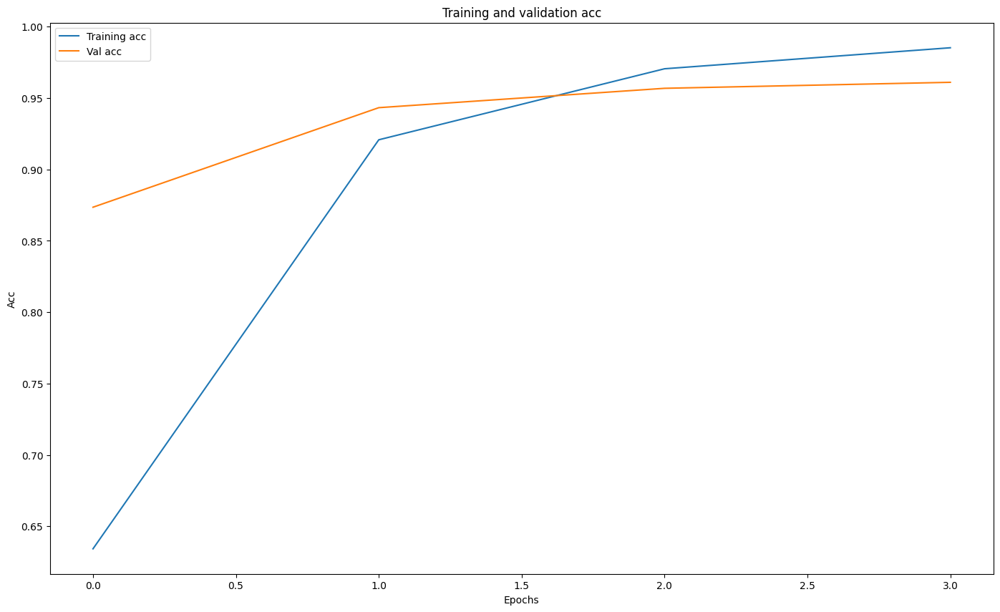

In [ ]:
visualization(train_acc, val_acc, is_loss = False)

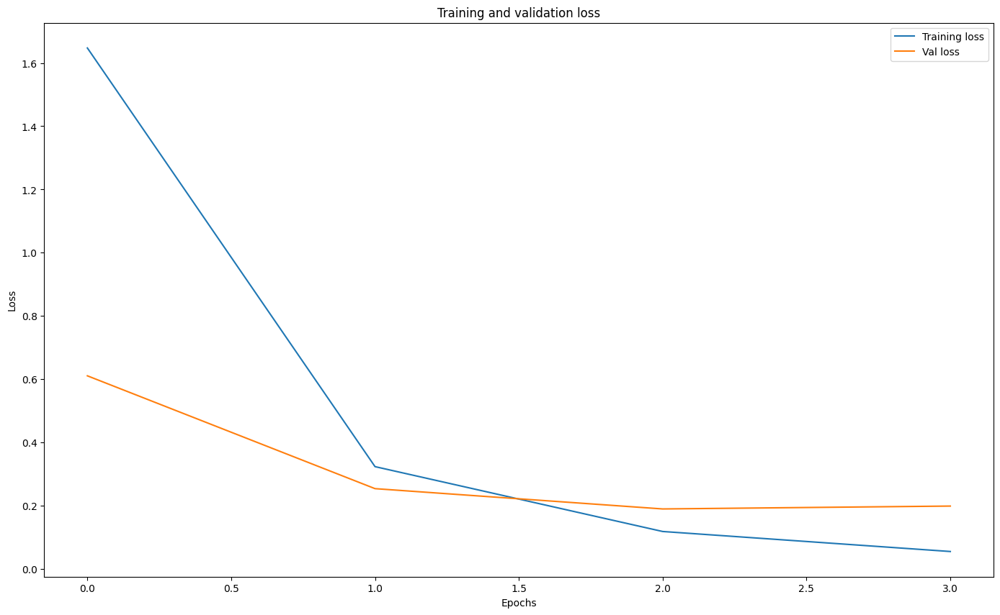

In [ ]:
visualization(train_loss, val_loss, is_loss = True)

In [ ]:
val_loss = val_loss[len(val_loss)-1]
val_acc = val_acc[len(val_acc)-1]
total_time = round(total_time / 60, 2)



# Создание временного датафрейма с данными
temp_df = pd.DataFrame({'name': [model_name],
                        'loss': [val_loss],
                        'acc': [val_acc],
                        'time': [total_time],
                        'learning_rate': [learning_rate],
                        'epochs': [num_epochs]})
# Объединение данных с помощью метода concat
models_df = pd.concat([models_df, temp_df], ignore_index=True)

models_df

,name,loss,acc,time,learning_rate,epochs
0,resnet152_model,0.198998,0.961024,1932.36,0.001,4


### Визуализация предсказаний на валидации

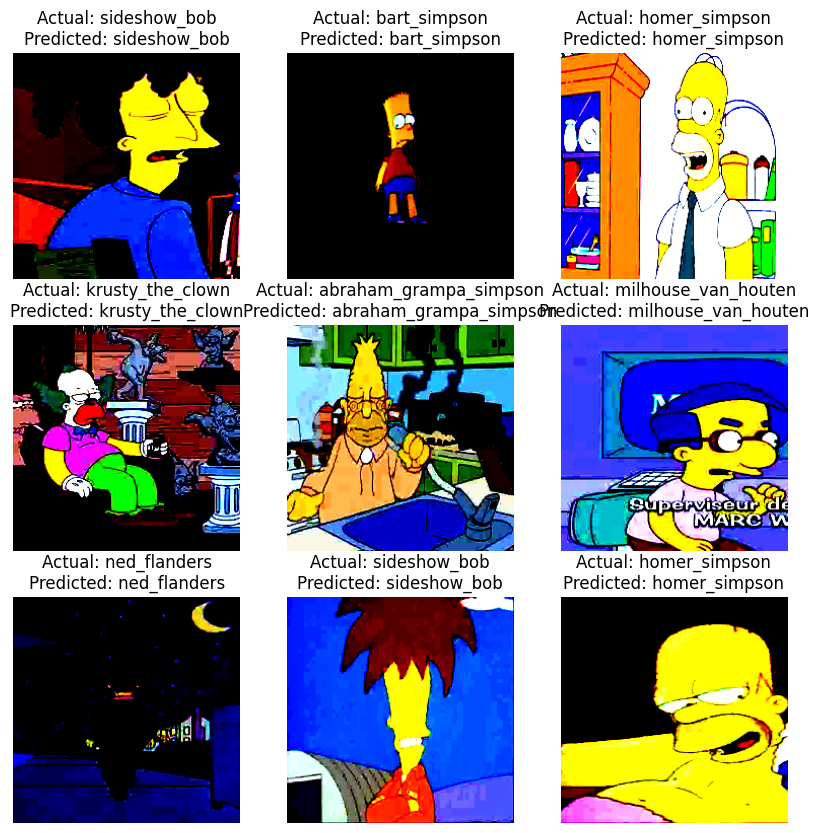

In [ ]:
# Выведем изображения с классами из валидации

model = resnet152_model

example, _ = random_split(val_dataset, [9, len(val_dataset) - 9])
example_loader = torch.utils.data.DataLoader(example, batch_size=9)


# переводим модель в режим оценки
model.eval()

# получаем один батч из 9 картинок и меток
X, y = next(iter(example_loader))

# переводим батч на GPU
X, y = X.to(device), y.to(device)

# получаем предсказания модели для батча
pred = model(X)

# выбираем наиболее вероятный класс для каждой картинки
pred = torch.argmax(pred, dim=1)

# создаем фигуру с 9 подграфиками
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# итерируем по картинкам, меткам и предсказаниям
for i, (img, label, prediction) in enumerate(zip(X, y, pred)):
    # определяем координаты подграфика
    row = i // 3
    col = i % 3
    # отображаем картинку на подграфике
    axes[row, col].imshow(img.permute(1, 2, 0).cpu().squeeze())
    # добавляем заголовок с фактическим и прогнозным классом
    axes[row, col].set_title(f'Actual: {class_names[label.item()]}\nPredicted: {class_names[prediction.item()]}')
    # убираем оси координат
    axes[row, col].axis('off')

# показываем фигуру
plt.show()

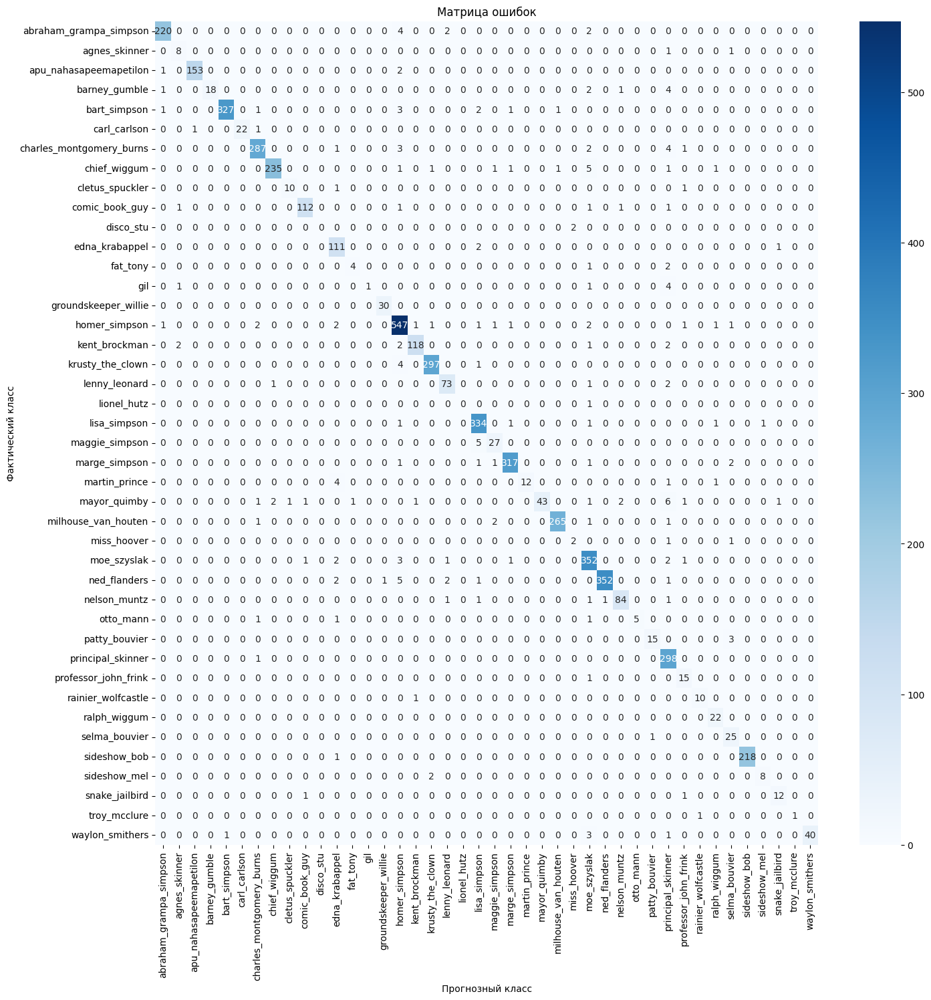

In [ ]:
# Матрица ошибок


# создаем список с названиями классов
class_names = train_dataset.label_encoder.classes_
# переводим модель в режим оценки
model.eval()

# создаем объект для вычисления confusion matrix
cm = ConfusionMatrix(task='multiclass', num_classes=num_classes).to(device)

# итерируем по всем батчам на тестовой выборке
for X, y in val_dataloader:
    # переводим батч на GPU
    X, y = X.to(device), y.to(device)
    # получаем предсказания модели для батча
    pred = torch.argmax(model(X), dim=1)
    # обновляем confusion matrix
    cm.update(pred, y)

# получаем confusion matrix в виде тензора
cm = cm.compute()

# создаем фигуру для отображения confusion matrix
plt.figure(figsize=(16, 16))

# используем функцию для визуализации confusion matrix с помощью Seaborn
sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Прогнозный класс')
plt.ylabel('Фактический класс')
plt.title('Матрица ошибок')

plt.show()

In [ ]:
from sklearn import metrics

# Установка модели в режим оценки (выключение режима обучения)
model.eval()

# Подготовка списков для предсказанных и истинных значений
y_pred = []
y_true = []

# Проход по валидационным данным и предсказываем значения
with torch.no_grad():
    for batch in val_dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)

        # Предсказание значений
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Представление предсказаний и истинных значений в виде массивов numpy
y_pred = np.array(y_pred)
y_true = np.array(y_true)

# Представление имен классов в отсортированном порядке
character_names = sorted(class_names)

# Создание матрицы ошибок (Confusion Matrix)
cnn_cm_simpsons = metrics.confusion_matrix(y_true, y_pred)

# Вычисление accuracy модели
cnn_accuracy_simpsons = metrics.accuracy_score(y_true, y_pred)

# Вывод отчета классификации
print(metrics.classification_report(y_true, y_pred, target_names=character_names))

# Вывод accuracy модели
print("Accuracy score: {}".format(cnn_accuracy_simpsons))

### Тест

In [ ]:
transform = models.ResNet152_Weights.DEFAULT.transforms()

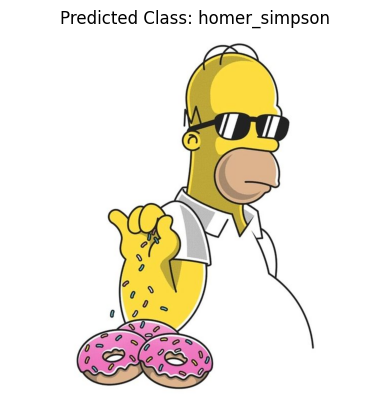

In [ ]:
url = 'https://i.pinimg.com/736x/77/5f/33/775f337a4afd8cbc83a20b5b5d66ee01.jpg'

classify_url_image(model, url, class_names)

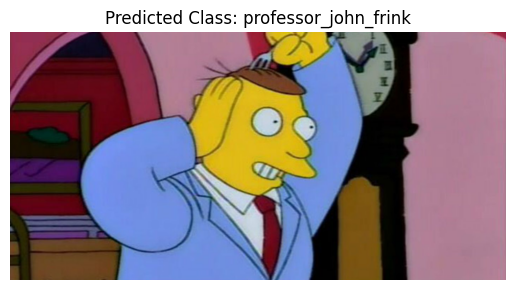

In [ ]:
# lionel_hutz
url = 'https://static1.srcdn.com/wordpress/wp-content/uploads/2019/10/Lionel-Hutz-in-The-Simpsons-5.jpg'

classify_url_image(model, url, class_names)

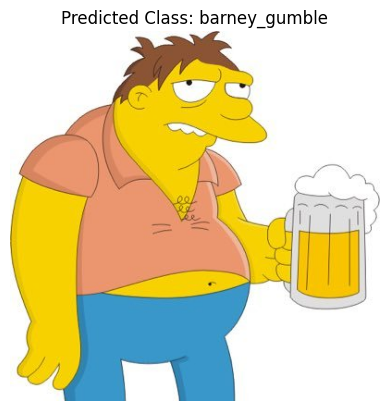

In [ ]:
# barney_gumble
url = 'https://pbs.twimg.com/profile_images/1106464941861756928/ih7F9SBC_400x400.jpg'

classify_url_image(model, url, class_names)

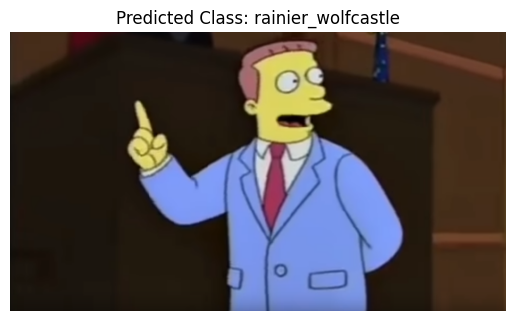

In [ ]:
# lionel_hutz
url = 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/aqiplqcyb4mhrrxzhdrh.png'

classify_url_image(model, url, class_names)

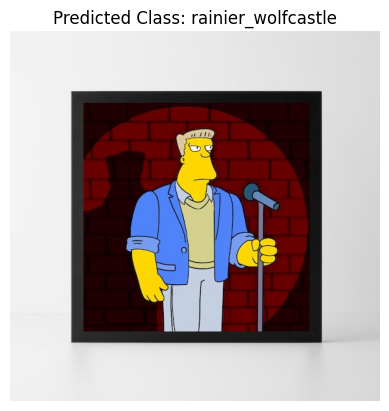

In [ ]:
# rainer_wolfcastle
url = 'https://i.etsystatic.com/32887768/r/il/9b9621/3684440590/il_570xN.3684440590_8wc4.jpg'

classify_url_image(model, url, class_names)

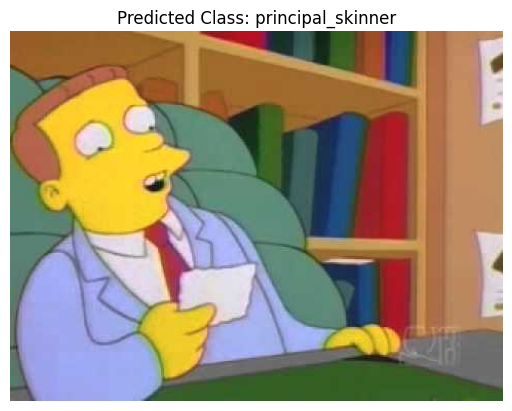

In [ ]:
# lionel_hutz
url = 'https://i.ytimg.com/vi/5yuL6PcgSgM/hqdefault.jpg'
classify_url_image(model, url, class_names)

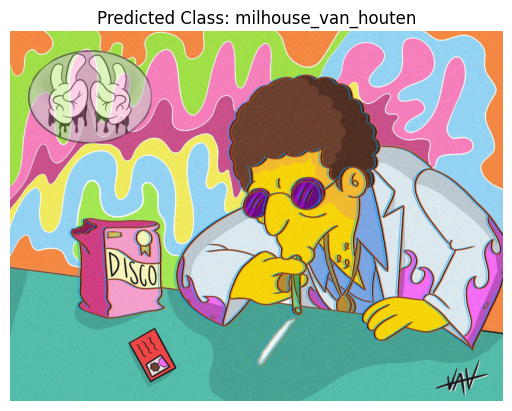

In [ ]:
# disco_stu
url = 'https://i.etsystatic.com/20846563/r/il/6e2be5/2271760966/il_fullxfull.2271760966_d54f.jpg'
classify_url_image(model, url, class_names)

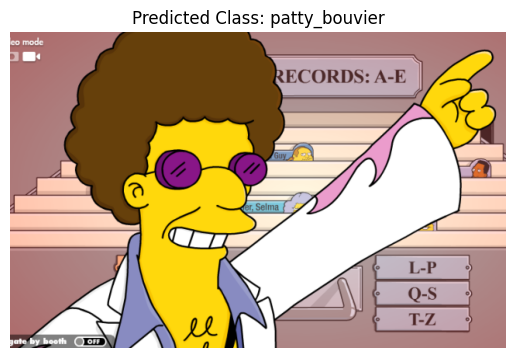

In [ ]:
# disco_stu
url = 'https://christopherfinlan.files.wordpress.com/2023/05/175b3-disco_stu_2528simpsons_official_site2529.png?w=640'
classify_url_image(model, url, class_names)

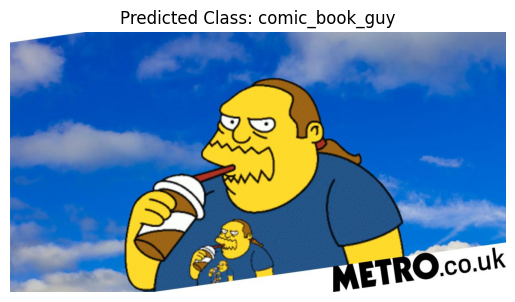

In [ ]:
# comic_book_guy
url = 'https://metro.co.uk/wp-content/uploads/2021/01/comic-guy-4248_1609771351.jpg?quality=90&strip=all&w=1200&h=630&crop=1'
classify_url_image(model, url, class_names)

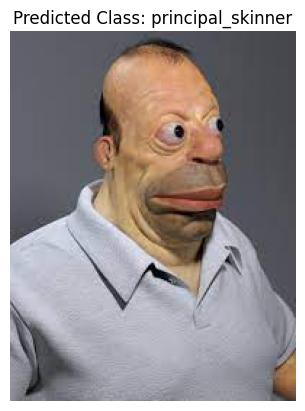

In [ ]:
url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTJVPRC4nQom1lI8ZHyeZinxgi26IeESAUJw28e1JLTD6qlIwEN_-VgSRaToozuumLtkRQ&usqp=CAU'
classify_url_image(model, url, class_names)

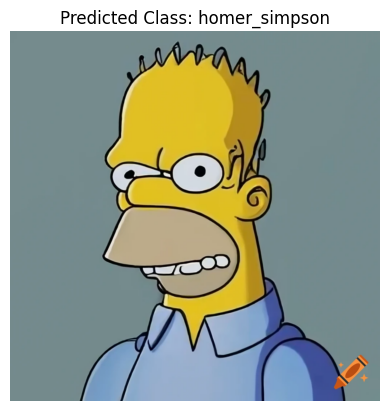

In [ ]:
url = 'https://pics.craiyon.com/2023-11-14/pVfMLZSkSVWDN8-F73CwYA.webp'
classify_url_image(model, url, class_names)

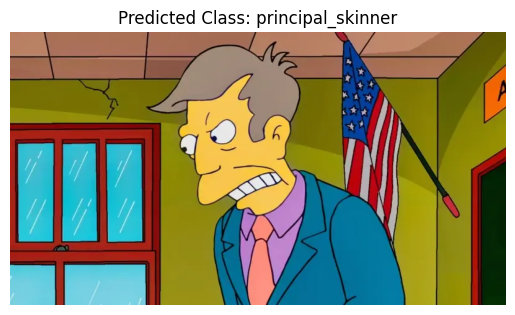

In [ ]:
# principal_skinner
url = 'https://a1cf74336522e87f135f-2f21ace9a6cf0052456644b80fa06d4f.ssl.cf2.rackcdn.com/images/characters/large/800/Principal-Skinner.The-Simpsons.webp'
classify_url_image(model, url, class_names)

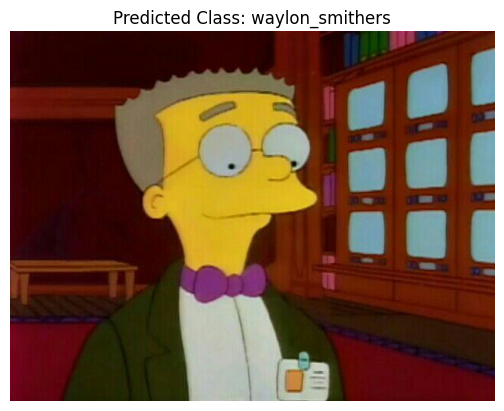

In [ ]:
# waylon_smithers
url = 'https://pm1.aminoapps.com/6624/e9358b3082184c87004984c3c39047d8754a1c1a_hq.jpg'
classify_url_image(model, url, class_names)

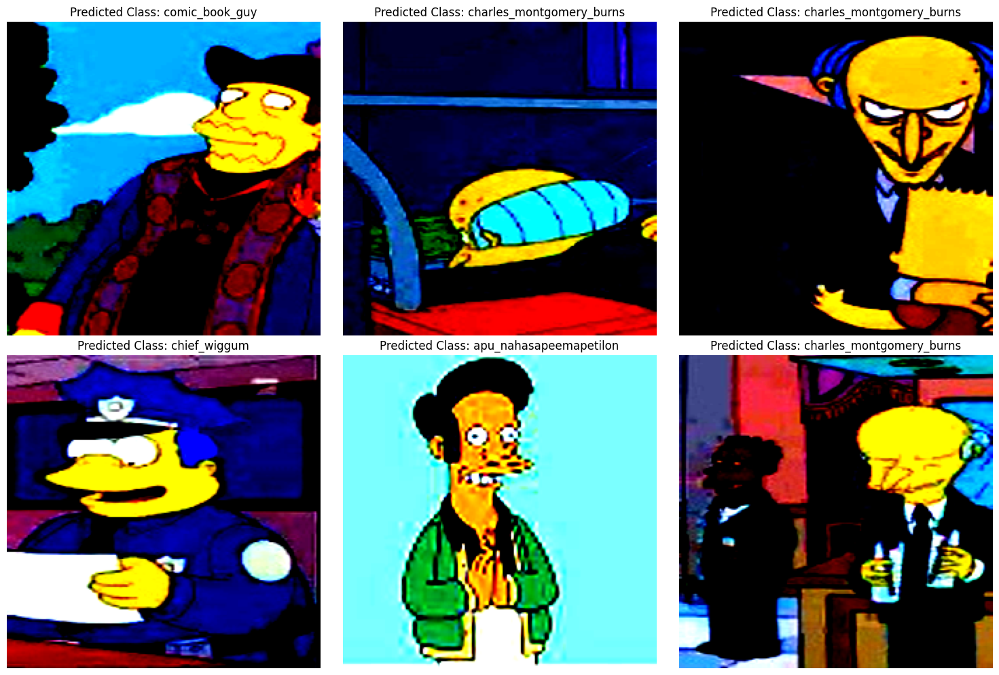

In [ ]:
# функция для классификации рандомных изображений в тестовом датасете

classify_random_images(model, test_dataset, class_names, 3, 2)  # В данном примере 2 строки с 3 изображениями в каждой

## efficientnet_b2() 77%

#### Загрузка модели, подготовка данных для передачи в модель

Выполним преобразование и аугментацию данных для использования с моделью ResNet-152.



In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
train_dataset.transform = transform
val_dataset.transform = transform
test_dataset.transform = transform

In [ ]:
train_dataset_f.transform = transform
val_dataset_f.transform = transform
test_dataset_f.transform = transform

In [ ]:
# Ещё раз выведем количество данных в тренировачных и тестовых выборках
print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

13744
4255
991


In [ ]:
# Создаём даталоадеры с сокращёнными классами и аугментированными малочисленными классами
train_dataloader = torch.utils.data.DataLoader(train_dataset,
                                    batch_size=32,
                                    shuffle=True)

val_dataloader = torch.utils.data.DataLoader(val_dataset,
                                    batch_size=32,
                                    shuffle=False)

test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                    batch_size=32,
                                    shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([32, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


In [ ]:
# Создаём даталоадеры с полным оригинальным набором данных
train_dataloader_f = torch.utils.data.DataLoader(train_dataset_f,
                                    batch_size=32,
                                    shuffle=True)

val_dataloader_f = torch.utils.data.DataLoader(val_dataset_f,
                                    batch_size=32,
                                    shuffle=False)

test_dataloader_f = torch.utils.data.DataLoader(test_dataset_f,
                                    batch_size=32,
                                    shuffle=False)

In [ ]:
img, label = next(iter(train_dataloader_f))
print(f"Размерность изображения: {img.shape} -> [размер батча, цветовые каналы, высота, ширина]")

Размерность изображения: torch.Size([32, 3, 224, 224]) -> [размер батча, цветовые каналы, высота, ширина]


### Тюнинг модели

In [ ]:
!pip install efficientnet_pytorch

  Preparing metadata (setup.py) ... done
  Created wheel for efficientnet_pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16428 sha256=f264dc506bb38999c2aee89dd9bea82c85272c8819598c010458317f8d4df2d7
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
Successfully built efficientnet_pytorch


In [ ]:
from efficientnet_pytorch import EfficientNet
model = EfficientNet.from_pretrained('efficientnet-b2')
model

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b2-8bb594d6.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b2-8bb594d6.pth
100%|██████████| 35.1M/35.1M [00:00<00:00, 269MB/s]


Loaded pretrained weights for efficientnet-b2


EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d((0, 1, 0, 1))
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False
    

In [ ]:
len(list(model.children()))

9

In [ ]:
# # Добавление последнего слоя модели на новый линейный слой с заданным числом выходных классов
# model.fc = nn.Linear(1408, num_classes)

# # Перемещение модели на устройство
# model = model.to(device)

# model

EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d((0, 1, 0, 1))
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False
    

In [ ]:
len(list(model.children()))

9

In [ ]:
model = create_model(model, 8, 1048, num_classes)

### Обучение

In [ ]:
model._fc

In [ ]:
# # Замена последнего слоя модели на новый линейный слой с заданным числом выходных классов
# model._fc = nn.Linear(1408, 42)

# # Перемещение модели на устройство
# model = model.to(device)

# model


EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d((0, 1, 0, 1))
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False
    

In [ ]:
model_name = 'efficient_b2()'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)


efficientnet_b2_model_ss, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:


RuntimeError: element 0 of tensors does not require grad and does not have a grad_fn

In [ ]:
# Добалвение последнего линейного слоя, обучение без заморозки

model_name = 'efficient_b2()'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)


efficientnet_b2_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 34.7315 Acc: 0.0468
Train Loss: 2.524569197310958  Acc: 0.33083527357392317
Val Loss: 34.731457373989166  Acc: 0.0468055230517201
Training time: 4.2838 minutes  Total: 4.283833333333333 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 3.9126 Acc: 0.0557
Train Loss: 283363540174799.7  Acc: 0.04787543655413271
Val Loss: 3.912645839933139  Acc: 0.055698572431546925
Training time: 3.8172 minutes  Total: 8.100999999999999 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████        ] 99/133 Loss: 3.8644 Acc: 0.0557

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-624a131307f2>", line 10, in <cell line: 10>
    efficientnet_b2_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
  File "<ipython-input-34-bf118fca1732>", line 46, in train
    val_loss, val_accuracy = evaluate(model, val_loader, loss_fn)
  File "<ipython-input-34-bf118fca1732>", line 84, in evaluate
    for X, y in data_loader:
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 630, in __next__
    data = self._next_data()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 674, in _next_data
    data = self._dataset_fetcher.fetch(index)  # may raise StopIteration
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/_utils/fetch.py", line 51, in fetch
    data = 

TypeError: object of type 'NoneType' has no len()

In [ ]:
# обучение модели с замороженными слоями на оригинальных данных

model_name = 'efficient_b2()'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

efficientnet_b2_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader_f,
                                                                      val_dataloader_f,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 1.0100 Acc: 0.7394
Train Loss: 1.6777675421320495  Acc: 0.6005478055927129
Val Loss: 1.010045826298798  Acc: 0.7393962552541078
Training time: 2.7515 minutes  Total: 2.7515 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 0.9443 Acc: 0.7639
Train Loss: 0.7081605605401721  Acc: 0.8050194279890439
Val Loss: 0.9442598134642695  Acc: 0.7638517386320214
Training time: 2.715 minutes  Total: 5.4665 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 0.9266 Acc: 0.7789
Train Loss: 0.39928581430567256  Acc: 0.8873176635454487
Val Loss: 0.9265767229584659  Acc: 0.7789453572793275
Training time: 2.698 minutes  Total: 8.1645 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 163/163 Loss: 1.0131 Acc: 0.7751
Train Loss: 0.28444487940664204  Acc: 0.9192305242372125
Val Loss: 1.0131078280235937  A

KeyboardInterrupt: 

In [ ]:
# обучение модели с замороженными слоями на изменённых данных

model_name = 'efficient_b2()'
learning_rate = 0.1
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

efficientnet_b2_model_s, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 6.6561 Acc: 0.6735
Train Loss: 9.759658509077028  Acc: 0.5068393480791619
Val Loss: 6.656099835438515  Acc: 0.6735314767142523
Training time: 2.4418 minutes  Total: 2.4418333333333333 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 6.4347 Acc: 0.7100
Train Loss: 4.7156452269055125  Acc: 0.7487630966239813
Val Loss: 6.4346623852181795  Acc: 0.710039784694594
Training time: 2.3557 minutes  Total: 4.7975 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 7.0021 Acc: 0.7180
Train Loss: 2.804881323752708  Acc: 0.8223224679860303
Val Loss: 7.002078897917449  Acc: 0.7179967236133864
Training time: 2.3177 minutes  Total: 7.115166666666667 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 133/133 Loss: 7.9675 Acc: 0.7243
Train Loss: 2.0850933251527874  Acc: 0.8641589057043073
Val Loss: 7.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-52-006ddefdfa4a>", line 12, in <cell line: 12>
    efficientnet_b2_model_s, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
  File "<ipython-input-34-bf118fca1732>", line 21, in train
    for index, (X_batch, y_batch) in enumerate(train_loader):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 630, in __next__
    data = self._next_data()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 674, in _next_data
    data = self._dataset_fetcher.fetch(index)  # may raise StopIteration
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/_utils/fetch.py", line 51, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/usr/local/lib/python3.10/dist-p

TypeError: object of type 'NoneType' has no len()

In [ ]:
# обучение модели с изменённым линейным слоем

model_name = 'efficient_b2()'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

efficientnet_b2_model_f, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader_f,
                                                                      val_dataloader_f,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 1.4015 Acc: 0.6421
Train Loss: 2.4380284870779794  Acc: 0.36270372526193245
Val Loss: 1.4015378160472203  Acc: 0.6420681551116334
Training time: 3.4492 minutes  Total: 3.4491666666666663 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 5102117133358830750531584.0000 Acc: 0.0134
Train Loss: 1.1874109233843239e+25  Acc: 0.035870197904540164
Val Loss: 5.102117133358831e+24  Acc: 0.013396004700352527
Training time: 3.2428 minutes  Total: 6.691999999999999 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 132/132 Loss: nan Acc: 0.0482
Train Loss: nan  Acc: 0.048166472642607684
Val Loss: nan  Acc: 0.0481786133960047
Training time: 3.2145 minutes  Total: 9.9065 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 132/132 Loss: nan Acc: 0.0482
Train Loss: nan  Acc: 0.05151338766006985
Val Loss: nan  Acc:

KeyboardInterrupt: 

In [ ]:
from efficientnet_pytorch import EfficientNet
model = EfficientNet.from_pretrained('efficientnet-b2')
model

Loaded pretrained weights for efficientnet-b2


EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d((0, 1, 0, 1))
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False
    

In [ ]:
len(list(model.children()))

9

In [ ]:
model = create_model(model, 7, 1408, num_classes)

In [ ]:
model

EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d((0, 1, 0, 1))
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False
    

In [ ]:
# обучение модели с замороженными слоями на изменённых данных


model_name = 'efficient_b2()'
learning_rate = 1e-2
num_epochs = 10
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

efficientnet_b2_model, train_loss, train_acc, val_loss, val_acc, total_time = train(model,
                                                                      train_dataloader,
                                                                      val_dataloader,
                                                                      loss_fn,
                                                                      optimizer,
                                                                      epochs=num_epochs)

Epoch 1/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 1.0420 Acc: 0.7408
Train Loss: 1.7383720328641492  Acc: 0.5814901047729919
Val Loss: 1.0420386433825457  Acc: 0.7407755581668625
Training time: 2.4265 minutes  Total: 2.4265 minutes
-----------------

Epoch 2/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 0.9384 Acc: 0.7704
Train Loss: 0.6889690356892209  Acc: 0.8119179278230501
Val Loss: 0.938390404938307  Acc: 0.7703877790834313
Training time: 2.355 minutes  Total: 4.781499999999999 minutes
-----------------

Epoch 3/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 0.9483 Acc: 0.7772
Train Loss: 0.3685277457500613  Acc: 0.8969732246798603
Val Loss: 0.9483484912635689  Acc: 0.7772032902467685
Training time: 2.3285 minutes  Total: 7.11 minutes
-----------------

Epoch 4/10:
Evaluating... [██████████████████████████████] 132/132 Loss: 0.9579 Acc: 0.7810
Train Loss: 0.22813790269455939  Acc: 0.939755529685681
Val Loss: 0.95789786657

Пока удалось достатичь максимальной точности в 77%, общее время обучения на 10 эпохах - 23 минуты. Все модели сильно переобучаются.

### Граффики ACC и Loss на трейне и валидации

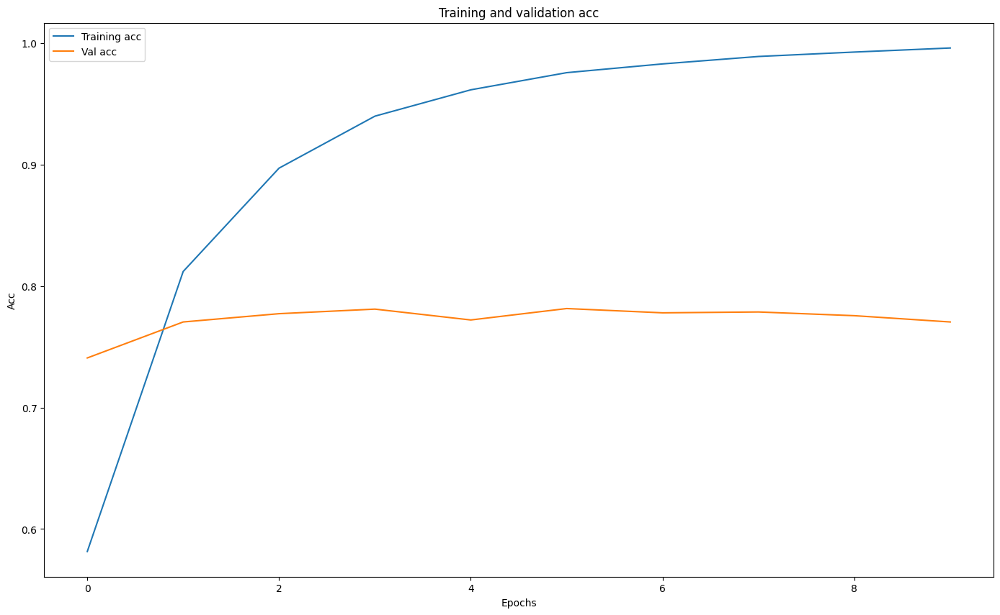

In [ ]:
visualization(train_acc, val_acc, is_loss = False)

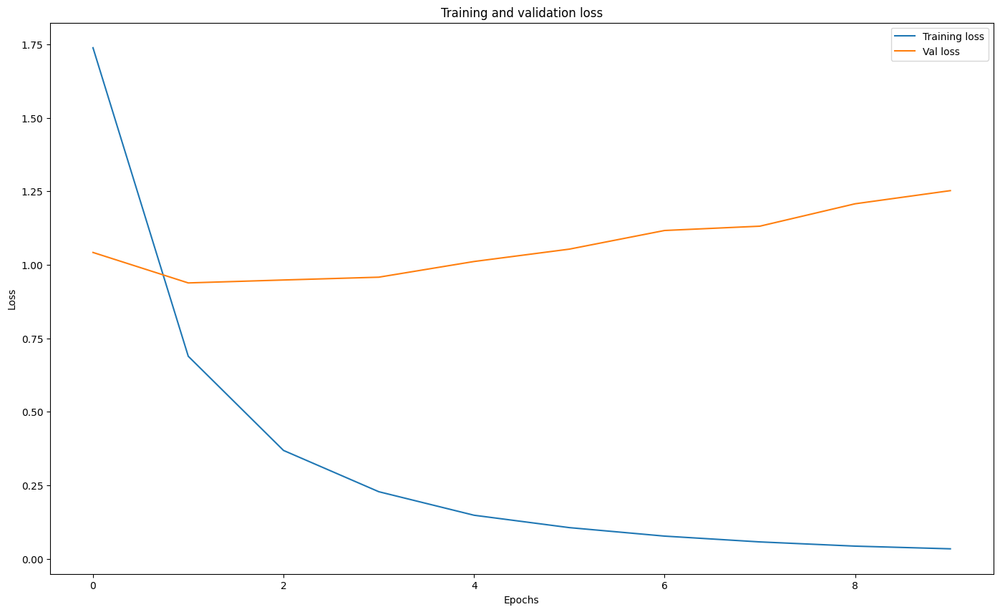

In [ ]:
visualization(train_loss, val_loss, is_loss = True)

In [ ]:
val_loss = val_loss[len(val_loss)-1]
val_acc = val_acc[len(val_acc)-1]
total_time = round(total_time / 60, 2)



# Создание временного датафрейма с данными
temp_df = pd.DataFrame({'name': [model_name],
                        'loss': [val_loss],
                        'acc': [val_acc],
                        'time': [total_time],
                        'learning_rate': [learning_rate],
                        'epochs': [num_epochs]})
# Объединение данных с помощью метода concat
models_df = pd.concat([models_df, temp_df], ignore_index=True)

models_df

,name,loss,acc,time,learning_rate,epochs
0,resnet152_model,26.259433,0.730670,36.09,0.10,10
1,efficient_b2(),1.252335,0.770388,23.46,0.01,10


### Визуализация предсказаний на валидации

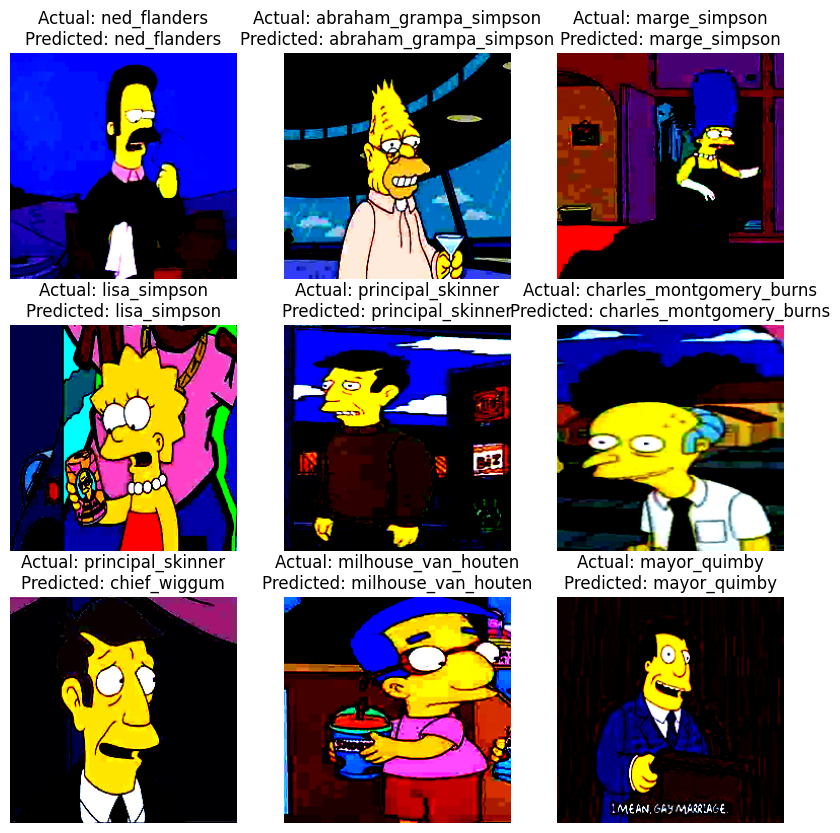

In [ ]:
# Выведем изображения с классами из валидации

model = resnet152_model

example, _ = random_split(val_dataset, [9, len(val_dataset) - 9])
example_loader = torch.utils.data.DataLoader(example, batch_size=9)


# переводим модель в режим оценки
model.eval()

# получаем один батч из 9 картинок и меток
X, y = next(iter(example_loader))

# переводим батч на GPU
X, y = X.to(device), y.to(device)

# получаем предсказания модели для батча
pred = model(X)

# выбираем наиболее вероятный класс для каждой картинки
pred = torch.argmax(pred, dim=1)

# создаем фигуру с 9 подграфиками
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# итерируем по картинкам, меткам и предсказаниям
for i, (img, label, prediction) in enumerate(zip(X, y, pred)):
    # определяем координаты подграфика
    row = i // 3
    col = i % 3
    # отображаем картинку на подграфике
    axes[row, col].imshow(img.permute(1, 2, 0).cpu().squeeze())
    # добавляем заголовок с фактическим и прогнозным классом
    axes[row, col].set_title(f'Actual: {class_names[label.item()]}\nPredicted: {class_names[prediction.item()]}')
    # убираем оси координат
    axes[row, col].axis('off')

# показываем фигуру
plt.show()

In [ ]:
# Матрица ошибок


# создаем список с названиями классов
class_names = train_dataset.label_encoder.classes_
# переводим модель в режим оценки
model.eval()

# создаем объект для вычисления confusion matrix
cm = ConfusionMatrix(task='multiclass', num_classes=num_classes).to(device)

# итерируем по всем батчам на тестовой выборке
for X, y in val_dataloader:
    # переводим батч на GPU
    X, y = X.to(device), y.to(device)
    # получаем предсказания модели для батча
    pred = torch.argmax(model(X), dim=1)
    # обновляем confusion matrix
    cm.update(pred, y)

# получаем confusion matrix в виде тензора
cm = cm.compute()

# создаем фигуру для отображения confusion matrix
plt.figure(figsize=(16, 16))

# используем функцию для визуализации confusion matrix с помощью Seaborn
sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Прогнозный класс')
plt.ylabel('Фактический класс')
plt.title('Матрица ошибок')

plt.show()

In [ ]:
from sklearn import metrics

# Установка модели в режим оценки (выключение режима обучения)
model.eval()

# Подготовка списков для предсказанных и истинных значений
y_pred = []
y_true = []

# Проход по валидационным данным и предсказываем значения
with torch.no_grad():
    for batch in val_dataloader:
        inputs = batch[0].to(device)
        labels = batch[1].to(device)

        # Предсказание значений
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)

        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Представление предсказаний и истинных значений в виде массивов numpy
y_pred = np.array(y_pred)
y_true = np.array(y_true)

# Представление имен классов в отсортированном порядке
character_names = sorted(class_names)

# Создание матрицы ошибок (Confusion Matrix)
cnn_cm_simpsons = metrics.confusion_matrix(y_true, y_pred)

# Вычисление accuracy модели
cnn_accuracy_simpsons = metrics.accuracy_score(y_true, y_pred)

# Вывод отчета классификации
print(metrics.classification_report(y_true, y_pred, target_names=character_names))

# Вывод accuracy модели
print("Accuracy score: {}".format(cnn_accuracy_simpsons))

### Тест

In [ ]:
transform = models.ResNet152_Weights.DEFAULT.transforms()

In [ ]:
url = 'https://i.pinimg.com/736x/77/5f/33/775f337a4afd8cbc83a20b5b5d66ee01.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# lionel_hutz
url = 'https://static1.srcdn.com/wordpress/wp-content/uploads/2019/10/Lionel-Hutz-in-The-Simpsons-5.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# barney_gumble
url = 'https://pbs.twimg.com/profile_images/1106464941861756928/ih7F9SBC_400x400.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# lionel_hutz
url = 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/aqiplqcyb4mhrrxzhdrh.png'

classify_url_image(model, url, class_names)

In [ ]:
# rainer_wolfcastle
url = 'https://i.etsystatic.com/32887768/r/il/9b9621/3684440590/il_570xN.3684440590_8wc4.jpg'

classify_url_image(model, url, class_names)

In [ ]:
# lionel_hutz
url = 'https://i.ytimg.com/vi/5yuL6PcgSgM/hqdefault.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# disco_stu
url = 'https://i.etsystatic.com/20846563/r/il/6e2be5/2271760966/il_fullxfull.2271760966_d54f.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# disco_stu
url = 'https://static.wikia.nocookie.net/simpsons/images/5/54/Future_Disco_Stu.png/revision/latest?cb=20141115003933'
classify_url_image(model, url, class_names)

In [ ]:
# comic_book_guy
url = 'https://metro.co.uk/wp-content/uploads/2021/01/comic-guy-4248_1609771351.jpg?quality=90&strip=all&w=1200&h=630&crop=1'
classify_url_image(model, url, class_names)

In [ ]:
url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTJVPRC4nQom1lI8ZHyeZinxgi26IeESAUJw28e1JLTD6qlIwEN_-VgSRaToozuumLtkRQ&usqp=CAU'
classify_url_image(model, url, class_names)

In [ ]:
url = 'https://pics.craiyon.com/2023-11-14/pVfMLZSkSVWDN8-F73CwYA.webp'
classify_url_image(model, url, class_names)

In [ ]:
# principal_skinner
url = 'https://a1cf74336522e87f135f-2f21ace9a6cf0052456644b80fa06d4f.ssl.cf2.rackcdn.com/images/characters/large/800/Principal-Skinner.The-Simpsons.webp'
classify_url_image(model, url, class_names)

In [ ]:
# waylon_smithers
url = 'https://pm1.aminoapps.com/6624/e9358b3082184c87004984c3c39047d8754a1c1a_hq.jpg'
classify_url_image(model, url, class_names)

In [ ]:
# функция для классификации рандомных изображений в тестовом датасете

classify_random_images(model, test_dataset, class_names, 3, 2)  # В данном примере 2 строки с 3 изображениями в каждой

# Вывод

В процессе предобрадобработки данных были выполнены следующие действия:
1. Предварительная балансировка классов путем снежения количества изображений в классах:
- "homer_simpson"
- 'ned_flanders'
- 'moe_szyslak'
- 'lisa_simpson'
- 'bart_simpson'
- 'marge_simpson'
- 'krusty_the_clown'
- 'principal_skinner'
- 'charles_montgomery_burns'
- 'milhouse_van_houten'

2. Двукратное увеличение количества изображений путём аугментации копий изображений в малочисленных классах:
- 'maggie_simpson',
- 'groundskeeper_willie',
- 'barney_gumble',
- 'selma_bouvier',
- 'carl_carlson',
- 'ralph_wiggum',
- 'patty_bouvier',
- 'martin_prince',
- 'professor_john_frink',
- 'snake_jailbird',
- 'cletus_spuckler',
- 'rainier_wolfcastle',
- 'agnes_skinner',
- 'sideshow_mel',
- 'otto_mann',
- 'gil',
- 'fat_tony',
- 'miss_hoover',
- 'disco_stu',
- 'troy_mcclure',
- 'lionel_hutz'

Данные преобразования способствовали улучшению точности классификации обучаемых моделей, а также позволили снизить время обучения моделей (на модели с самой высокой точностью время обучения снизилось на 10% по сравнению с той же моделью обучаемой на оригинальном наборе данных).

Самую высокую точность классификации изображений удалось получить на основе модели *ResNet152* - около 97%. Остальные испытанные модели (кроме ResNet50, точность - 84%) не смогли достичь удворительной точности, а также показали склонность к переобучению.

Гиперпараметры модели *ResNet152*: оптимизатор *SGD(model.parameters(), lr=0.001, momentum=0.9, nesterov=True)*. Полное обучение *преобразованных данных* *без заморозки слоёв*. Количество эпох - 4, время обучения 29 минут (самую высокую точность данная модель показала при продолжении обучения на 5-ой эпохе, точность составила около 98%).

Данная модель с высокой точностью классифицирует персонажей, для которых было собрано достаточно тренировочных данных. В основном модель ошибается при классификации персонажей, для которых было собрано мало данных. Чтобы улучшить точность модели необходимо увеличить количество тренировочных данных в малочисленных классах.





PS. если обучать при batch_size = 64, то Colab падает после одного, максимум двух запусков сессий обучений по 10 эпох (около 30-40 минут работы), при этом нет никаких заментых изменений в скорости обучения моделей. При уменьшении батчей до 32, удавалась успевать обучать 4-5 моделей по 10 эпох(более часа вычислительных работ в Colab).

PPS. Все преобразования с даннымы и правки кода в Colab лучше делать на cpu и потом уже при непосредственном начале обучения моделей переключаться на cuda. По всей видимости, Colab отсчитывает runtime и даже если просто долго работать с данными и выполнять нетяжёлые операции после нескольких часов Colab обрубает доступ к GPU и принудительно переводит на cpu.

PPPS. Если зарегать новый акк в Google и начать в нём сразу работать в Colab-е, то акк могут быстро заблокировать (где-то через 15-20 мин работы), есть теоритическая возможность разблокировки, но 3 заблокированных акк так и не восстановили.

PPPPS. Перекидывать один и тот же проект на разные 'прогретые' акк можно(можно давать права на правки на других акк или делать каждый раз копии на другом акк). Colab такую деятельность не блокирует, время и мощности не урезает.